In [17]:
import os
import sys
from pathlib import Path

import cv2 as cv
import h5py
import matplotlib.pyplot as plt
import napari
import numpy as np
import pandas as pd
import skimage
from joblib import Parallel, delayed
from skimage import exposure, io
from skimage.util import img_as_ubyte
from tqdm.notebook import tqdm, trange
import cv2

In [18]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"
match_info_dir = data_dir / "match"

In [19]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import utils as my_utils
import transform 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Import IMC data 

In [20]:
from skimage.transform import rotate

h5_data_dir = p_dir / "data" / "h5"


def get_imgs(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["markers"])
    return imgs, labels

def get_imgs_sims(experiment, name):
    with h5py.File(h5_data_dir / f"{experiment}.hdf5", "r") as f:
        imgs = f[name][:]
        labels = list(f[name].attrs["labels"])
    return imgs, labels

def contrast_stretching(img, p_min=40, p_max=95):
    # Contrast stretching
    p2, p98 = np.percentile(img, (p_min, p_max))
    img_rescale = exposure.rescale_intensity(
        img, in_range=(p2, p98), out_range=(0, 255)
    ).astype(np.uint8)
    return img_rescale

def crop_img(img, info):
    # Rotate img
    y, h_region, x, w_region = info["bbox"]
    rotation = info["rotation_init"]
    rotation_small = info["rotation_adjust"]
    border = info["border"]

    img = rotate(img, rotation, resize=True)
    img = cv2.copyMakeBorder(
        img, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
    )
        
    # Get region for img
    if "img_region" in info.keys():
        row_min, row_max, col_min, col_max = info["img_region"]
        img = img[row_min:row_max, col_min:col_max]
        img = rotate(img, rotation_small, resize=True)
        
    if "affine" in info.keys():
        aff = info["affine"]
        pad = info["pad"]
        y = y - pad
        h_region = h_region + 2*pad
        x = x - pad
        w_region = w_region + 2*pad
        y = 0 if y < 0 else y
        x = 0 if x < 0 else x
        img_aff = img[y : y + h_region, x : x + w_region]
        img = transform.apply_global_affine(img_aff, img_aff, aff)
        y, h_region, x, w_region = info["bbox_aff"]
        
    img = img[y : y + h_region, x : x + w_region]
    img = contrast_stretching(img)
    img = img_as_ubyte(img)
    return img


In [21]:
match_info_dir = p_dir / "data" / "match"
experiment = 'Lung' 

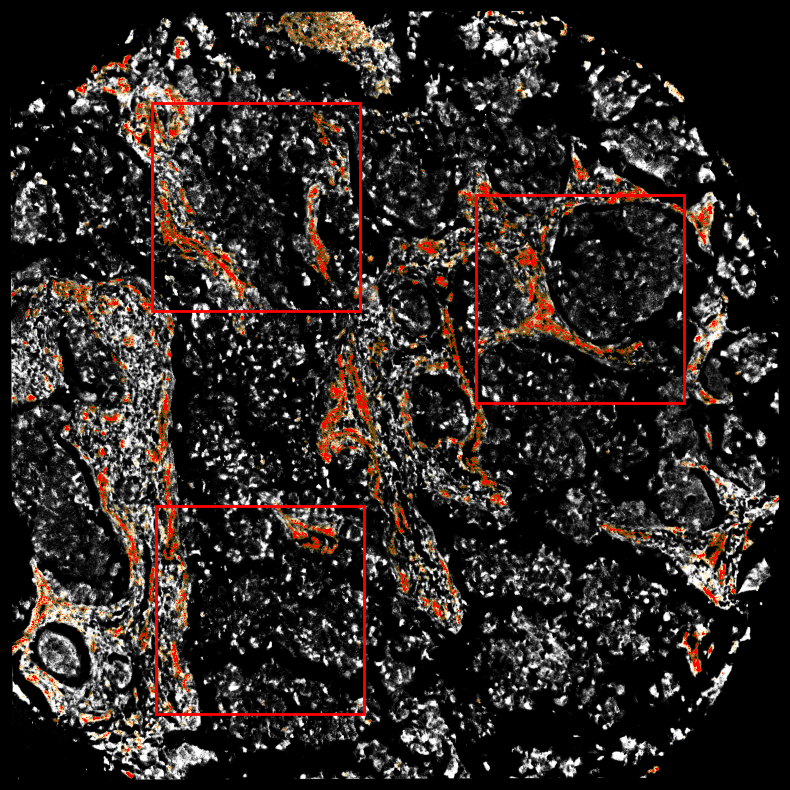

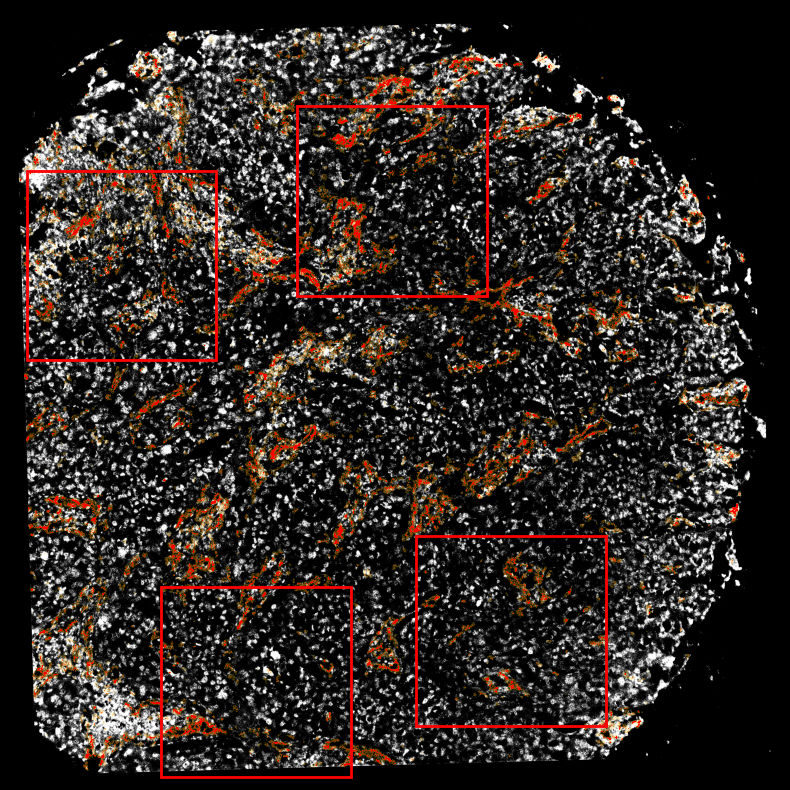

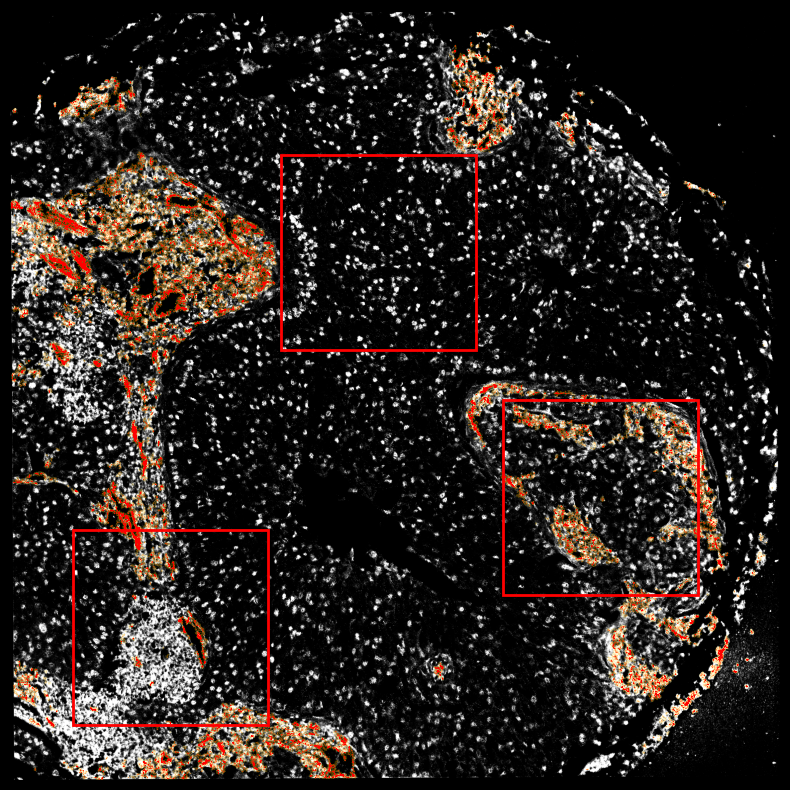

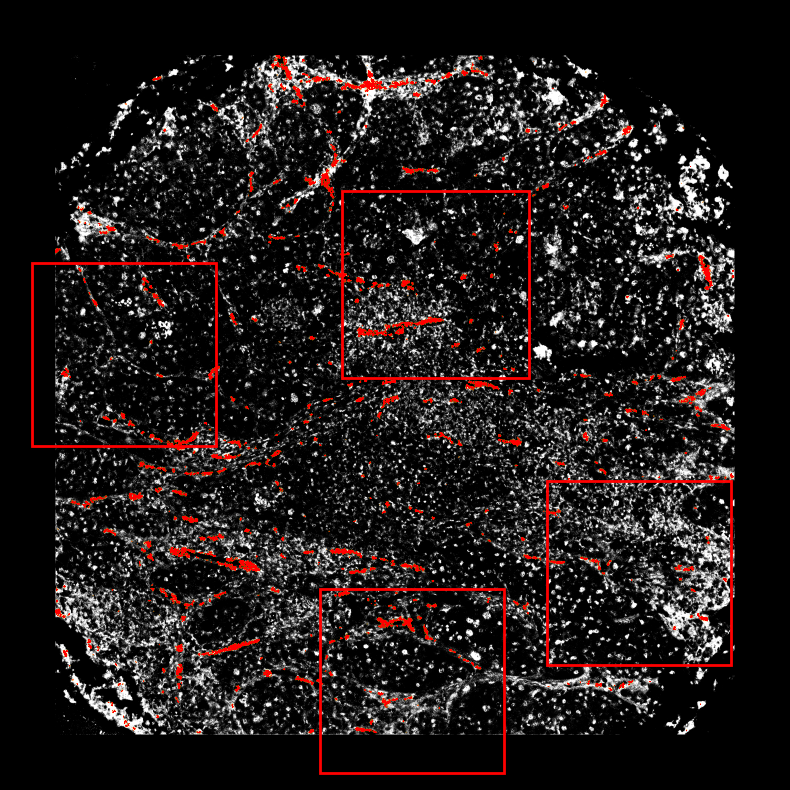

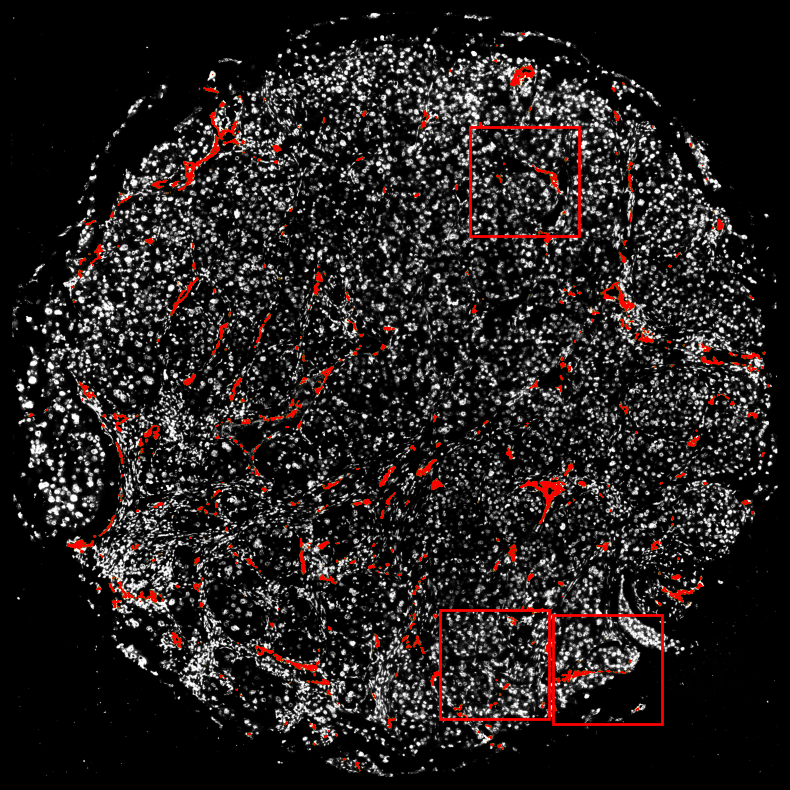

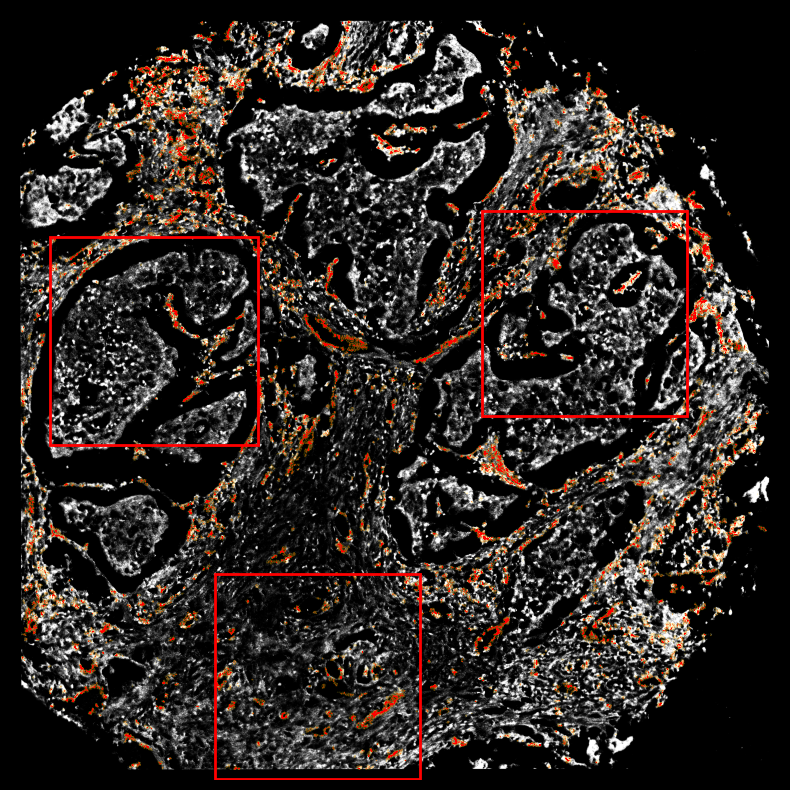

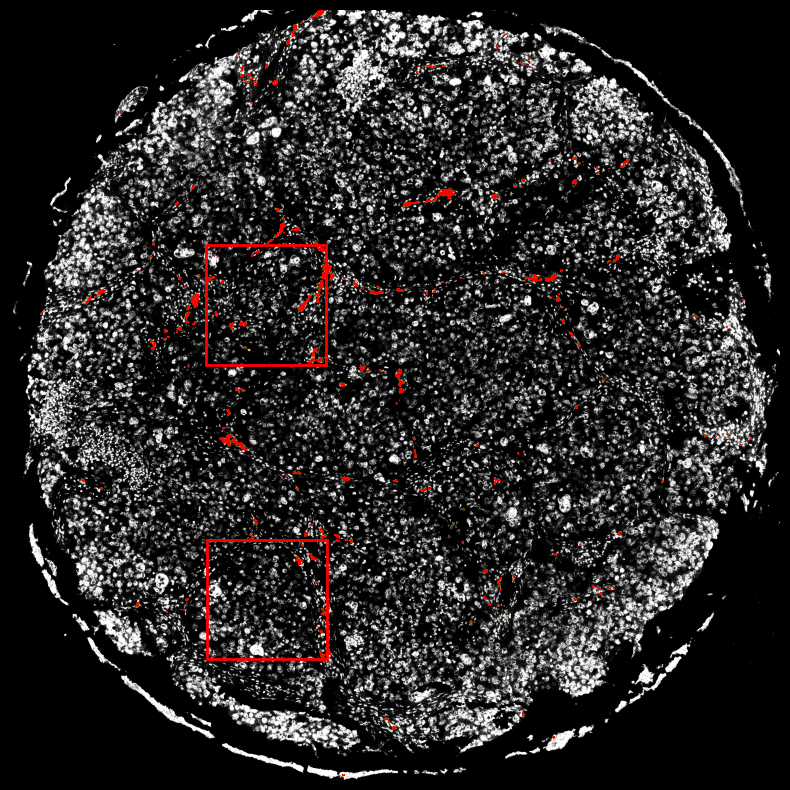

In [22]:
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

subset_lung = ["HistoneH3", 'DNA1', 'DNA2']
cores = ["B5", "C6", "D4", "E4", 'E6', "F4", "F7"]

# Choose colormap
cmap = pl.cm.autumn_r
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

cmap = pl.cm.gray
my_cmap2 = cmap(np.arange(cmap.N))
my_cmap2[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap2 = ListedColormap(my_cmap2)

for core in cores:
    datasets = [f'{core}_{i}' for i in range(1,5)]
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        imgs, markers = get_imgs(f"{experiment} {core}", "IMC")
        
        img_dapi = np.max(contrast_stretching(imgs[[markers.index(marker) for marker in subset_lung]]), axis=0)
        img_dapi = contrast_stretching(img_dapi, p_max=99.9)
        img = contrast_stretching(imgs[markers.index('CD31')], p_min=0, p_max=100)
        try:
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            rotation = info["rotation_init"]
            border = info["border"]
            
            img_dapi = rotate(img_dapi, rotation, resize=True)
            img_dapi = cv2.copyMakeBorder(
                img_dapi, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            img = rotate(img, rotation, resize=True)
            img = cv2.copyMakeBorder(
                img, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            break
        except:
            continue
        
    fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
    ax.imshow(img_dapi, cmap=my_cmap2)
    v_max = np.percentile(img, 99)
    v_max = 0.1 if v_max == 0 else v_max
    ax.imshow(img, vmax=v_max, cmap=my_cmap)
    ax.axis("off")
    
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        try:
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            y, h_region, x, w_region = info["bbox"]

            # highlight matched region
            rect = plt.Rectangle(
                (x, y), w_region, h_region, edgecolor="r", facecolor="none", lw=2
            )
            ax.add_patch(rect)
        except:continue


In [23]:
imgs_imc, markers = get_imgs(f"{experiment} F7", "IMC")


In [24]:
# napari.view_image(imgs_imc, name=markers, channel_axis=0, visible=False)

# Analysis of CD31 Intensity 

Plot the intensity distribution of cd31 markers and show examples at different threshold

In [25]:
import seaborn as sns
import anndata as ad

In [26]:
# Read Protein clustering info
path = data_dir / "adata" / f"{experiment}.h5ad"
adata_IMC_cluster = ad.read_h5ad(path)
adata_IMC = adata_IMC_cluster[~adata_IMC_cluster.obs.Dataset.isin(['F7_1', 'F7_2'])]

C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


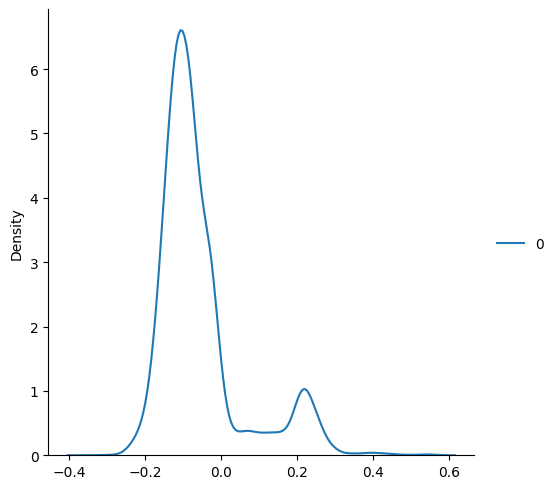

In [27]:
sns.displot(pd.DataFrame(adata_IMC[:, 'CD31'].X), kind="kde")

## Plot cell mask

In [34]:
from typing import List
import matplotlib
import skimage
from skimage import measure


def get_masks(mask_folder, dataset):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name and dataset in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition = name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks


def create_clustered_cell(mask, label2cell, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]), dtype=float)*np.nan

    for cells, intensity in label2cell.items():
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols] = intensity

    return img


def get_contour(mask: np.ndarray) -> List[List[float]]:
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

In [35]:
masks = get_masks(data_dir / "masks", f"{experiment}")

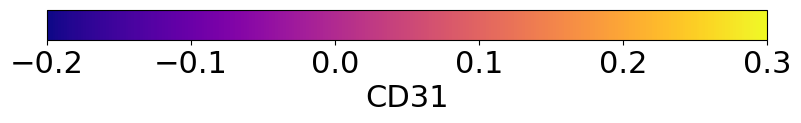

In [45]:
import matplotlib.pyplot as plt
import matplotlib as mpl
matplotlib.rcParams.update({'font.size': 22})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(8, 2))
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.15])

# Set the colormap and norm to correspond to the data for which
# the colorbar will be used.
cmap = mpl.cm.plasma
norm = mpl.colors.Normalize(vmin=-0.2, vmax=0.3)

cb1 = mpl.colorbar.ColorbarBase(ax1, cmap=cmap,
                                norm=norm,
                                orientation='horizontal')
cb1.set_label('CD31')

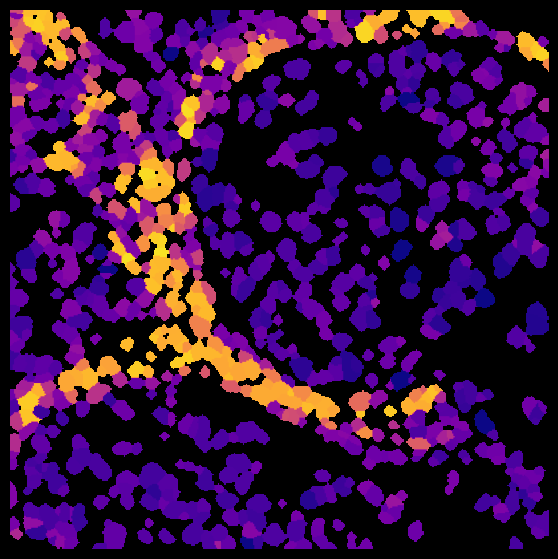

In [40]:
for dataset in adata_IMC.obs['Dataset'].unique():
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == dataset]
    try:
        mask = masks["_".join([experiment, dataset])]
        contours = get_contour(mask)
    except:
        print(dataset)
        continue
     # Get label2cell dict
    
    label2cell = {}
    cell_ids = adata_fov.obs.Cell.to_list()
    intensities = adata_fov[:,'CD31'].X.flatten()
    
    for i, cell in enumerate(cell_ids):
        label2cell[cell] = intensities[i]

    img = create_clustered_cell(mask, label2cell)

    fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
    ax.imshow(img, cmap='plasma', vmin=-0.2, vmax=0.3)
    ax.axis("off")
    plt.show()
    break

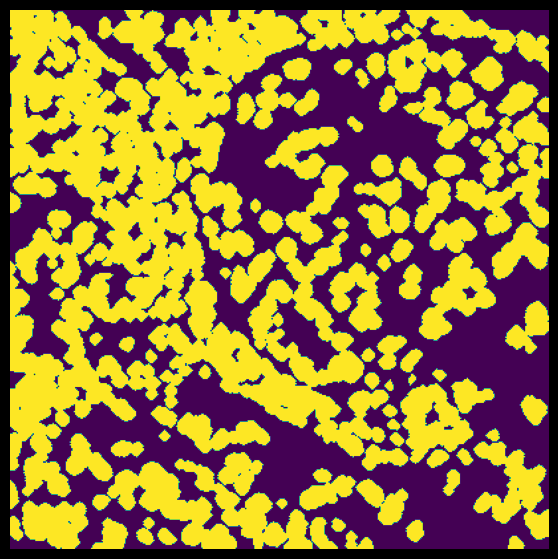

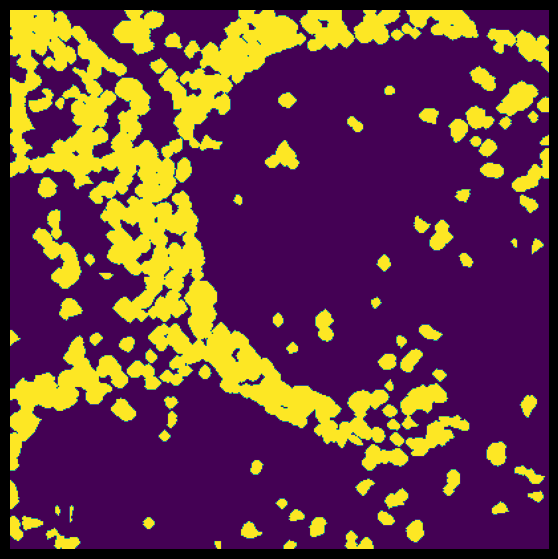

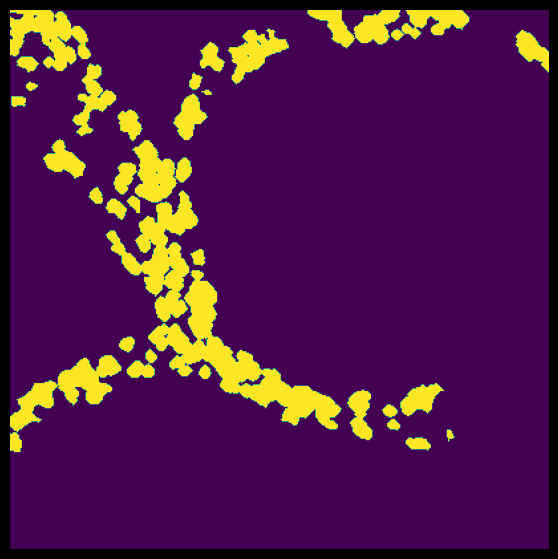

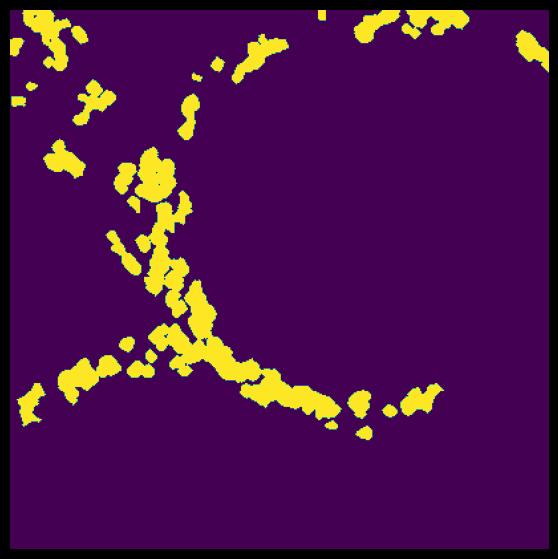

In [47]:
thresh = [-0.2, -0.1, 0.0, 0.1] 
for t in thresh:
    fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
    ax.imshow(img>t)
    ax.axis("off")
    plt.show()

# New CD31 analysis

## Import SIMS data

In [9]:
import scanpy as sc
import anndata as ad

# Import spatial omics library
import athena as ath
from spatialOmics import SpatialOmics

In [10]:
experiment = "Lung"
cores = ['B5', 'C6', 'D4', 'E4', 'E6', 'F4']
datasets = [f'{core}_{i}' for core in cores for i in range(1,5)] + ['F7_3', 'F7_4']


In [11]:
import palettable
heatmap_cmp = palettable.cmocean.diverging.Balance_20.mpl_colormap


In [12]:
def read_props(dataset, experiment):
    df_morph = pd.read_csv(data_dir / "props" / f"morphology_IMC_{experiment}_{dataset}.csv")
    df_intensity_IMC = pd.read_csv(data_dir / "props" / f"intensity_IMC_{experiment}_{dataset}.csv")
    df_intensity_TS = pd.read_csv(data_dir / "props" / f"intensity_TS_{experiment}_{dataset}_auto.csv")

    return df_morph, df_intensity_IMC, df_intensity_TS

In [13]:
%%capture 

adatas = []
adatas_raw = []
df_sums = []
for dataset in datasets:
    try:
        df_morph, df_intensity_IMC, df_intensity_TS = read_props(dataset, experiment)
        print(f'Sucessfully read dataset {dataset}') 
    except:
        print(f'{dataset} cannot be read') 
        continue
    try:
        df_intensity_TS.drop(['Rest', 'Total'], axis=1, inplace=True)
    except:
        pass
    df_intensity_TS.iloc[:, 1:] = df_intensity_TS.iloc[:, 1:].multiply(
        df_morph["area"], axis=0
    )
    # data_all = df_intensity_TS.iloc[:, 1:].values
    # data_all_norm = (data_all+0.1)/(np.percentile(data_all,50,axis=1,keepdims=True)+0.1)
    # data_all_norm = MinMaxScaler().fit_transform(data_all)
    # df_intensity_TS.iloc[:, 1:] = data_all_norm
    
    # Merge TS and IMC data
    df = df_intensity_TS
    df.set_index("Id", inplace=True)
    df_sums.append(df.sum(axis=0))
    
    # Put to adata format
    adata = sc.AnnData(df.values)
    adata.var_names = df.columns.tolist()
    adata.obs["Cell"] = df.index.tolist()
    adata.obs["Dataset"] = dataset
    adata.obs["Core"] = dataset.split("_")[0]
    adata.obsm["spatial"] = df_morph[["centroid-0", "centroid-1"]].to_numpy()
    
    # FPM normalize
    sc.pp.normalize_total(adata, target_sum=1e5)
    # sc.pp.log1p(adata, base=2)
    adatas_raw.append(adata.copy())
    
    # Standard scale
    sc.pp.scale(adata)
    adatas.append(adata)
    
adata = ad.concat(adatas, join="inner")
adata_raw = ad.concat(adatas_raw, join="inner")

In [14]:
# sc.pl.heatmap(adata, adata.var_names, groupby='Core', swap_axes=False, cmap='bwr', figsize=(20,10), standard_scale='obs', use_raw=False)

In [15]:
# Read Protein clustering info
path = data_dir / "adata" / f"{experiment}.h5ad"
adata_IMC_cluster = ad.read_h5ad(path)


C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [16]:
adata_IMC_cluster

AnnData object with n_obs × n_vars = 19507 × 12
    obs: 'Cell', 'Dataset', 'Core', 'leiden', 'Type', 'Region'
    uns: 'Dataset_colors', 'Region_colors', 'Type_colors', 'dendrogram_Type', 'dendrogram_leiden', 'leiden', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_scanorama', 'X_umap', 'spatial'
    obsp: 'connectivities', 'distances'

In [17]:
adata = adata[~adata.obs.Dataset.isin(['F7_1', 'F7_2'])]
adata_IMC = adata_IMC_cluster[~adata_IMC_cluster.obs.Dataset.isin(['F7_1', 'F7_2'])]

In [18]:
df_sum = pd.concat(df_sums, axis=1).mean(axis=1)
mz_qc = df_sum[(df_sum > 14000)].index.tolist()
# mz_qc = df_sum[(df_sum > 220)].index.tolist()

In [19]:
len(mz_qc)

177

In [20]:
adata = adata[:, mz_qc]
adata_raw = adata_raw[:, mz_qc]

## Get literature lut

In [21]:
SIMS_masses = adata.var_names

In [22]:
# Read litterature lut
file_path = data_dir / "metadata" / 'Putative_annotation_09012022.xlsx'
df = pd.read_excel(file_path)
lum = df['m/z'].to_numpy()

# get matched table by looking at difference with error
error = 0.4
matched_dfs = []
for mz in SIMS_masses.astype(float):
    if mz < 1.1:
        continue
    diff = lum-mz
    matched = df[abs(diff)<error]
    if len(matched) > 0:
        matched.loc[:,'SIMS mz'] = mz
        matched_dfs.append(matched)
    else:
        matched = pd.DataFrame([['', '', '', '', mz]], columns=df.columns.tolist() + ['SIMS mz'])
        matched_dfs.append(matched)
matched = pd.concat(matched_dfs)

C:\Users\thu71\AppData\Local\Temp\ipykernel_564\1921335408.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matched.loc[:,'SIMS mz'] = mz
C:\Users\thu71\AppData\Local\Temp\ipykernel_564\1921335408.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matched.loc[:,'SIMS mz'] = mz
C:\Users\thu71\AppData\Local\Temp\ipykernel_564\1921335408.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

In [23]:
# Get all info from litterature excel
SIMS_masses_subset = np.array(matched['SIMS mz'].to_list(), dtype=float).astype(str)
SIMS_masses_subset = pd.Index(SIMS_masses_subset)

matched.loc[matched['Molecules'] != '', 'Molecules'] = ' ' + matched.loc[matched['Molecules'] != '', 'Molecules']
SIMS_name_subset = np.array(matched['Molecules'].to_list()).astype(str)
SIMS_name_subset = pd.Index(SIMS_name_subset)
SIMS_name_subset = SIMS_name_subset

SIMS_nm_subset = SIMS_masses_subset + 'm/z' + SIMS_name_subset 

SIMS_type_subset = np.array(matched['Type'].to_list()).astype(str)
SIMS_type_subset = pd.Index(SIMS_type_subset)

print(f"Number of matched m/z: {len(SIMS_masses_subset)}")

Number of matched m/z: 176


In [24]:
adata_all = adata.copy()
adata = adata[:, SIMS_masses_subset]
adata.var_names = SIMS_nm_subset

C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [25]:
adata_raw = adata_raw[:, SIMS_masses_subset]
adata_raw.var_names = SIMS_nm_subset


## Put sims in their location

In [26]:
from skimage import measure, exposure
from skimage.transform import rescale, resize

# Read mask image
def get_masks(mask_folder):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition = name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks

def get_contour(mask: np.ndarray):
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

from skimage.measure import block_reduce
from sklearn.neighbors import NearestNeighbors

def mean_block(img, size):
    reduced = block_reduce(img, block_size=(size, size), func=np.mean)
    img_mean = np.repeat(reduced, size, axis=0)
    img_mean = np.repeat(img_mean, size, axis=1)
    img_mean[:img.shape[0], :img.shape[1]]
    return reduced, img_mean 

def repeat_img(reduced, size, img_shape):
    img_mean = np.repeat(reduced, size, axis=0)
    img_mean = np.repeat(img_mean, size, axis=1)
    img_mean[:img_shape[0], :img_shape[1]]
    return img_mean 

def get_distance(reduced):
    x,y = np.where(reduced)
    xii = np.arange(len(reduced))
    yii = np.arange(len(reduced[0]))
    xi, yi = np.meshgrid(xii,yii)
    xi = xi.flatten()
    yi = yi.flatten()

    neigh = NearestNeighbors(n_neighbors=1)
    neigh.fit(np.vstack([y,x]).T)

    d, n = neigh.kneighbors(np.vstack([yi, xi]).T, return_distance=True)
    
    distance_img = np.zeros(reduced.shape)
    distance_img[xi, yi] = d.flatten()
    
    return distance_img

def get_imgs_index(imgs, index_list, fov_dim):

    imgs_subset = imgs[index_list, :, :]
    img_combined = np.sum(imgs_subset, axis=0)
    img_downscale = resize(img_combined, (fov_dim, fov_dim), anti_aliasing=False)
    
    p2, p98 = np.percentile(img_downscale, (0, 99.9))
    img_downscale = exposure.rescale_intensity(
        img_downscale, in_range=(p2, p98), out_range=(0, 255)
    )
    return img_downscale


In [27]:
masks = get_masks(data_dir / "masks")


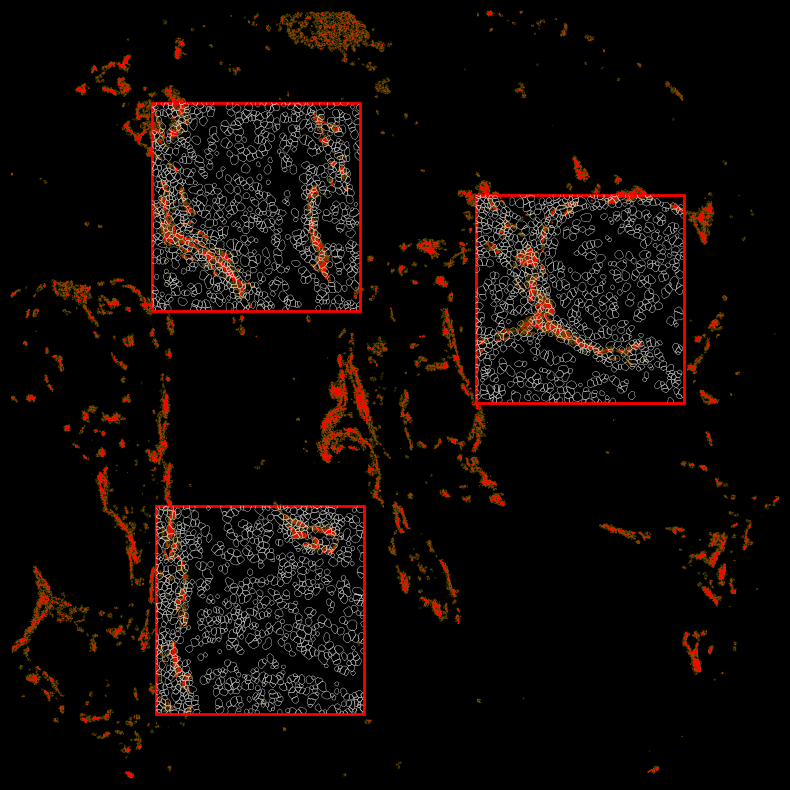

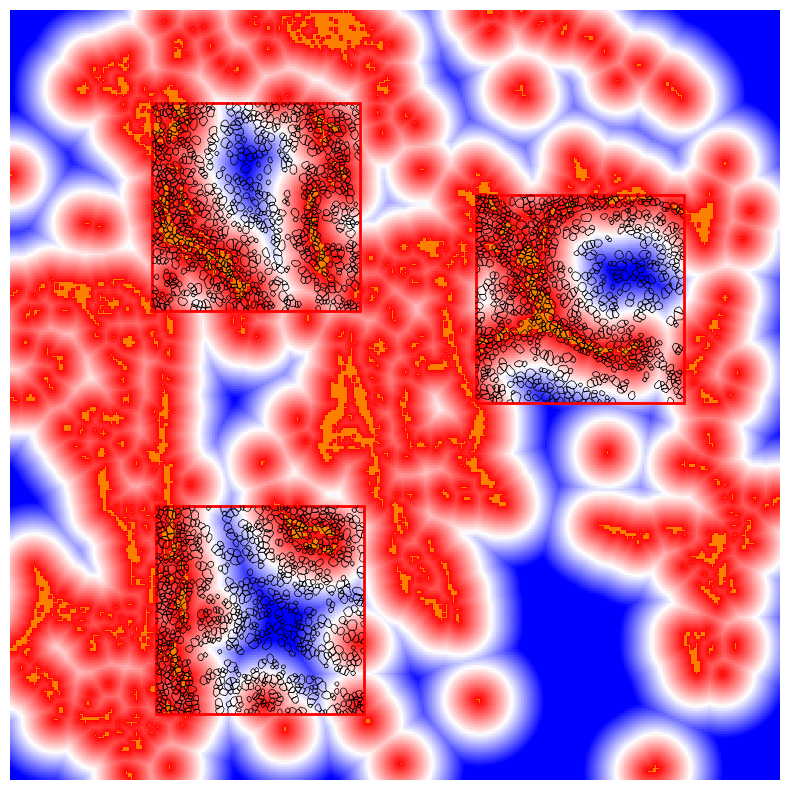

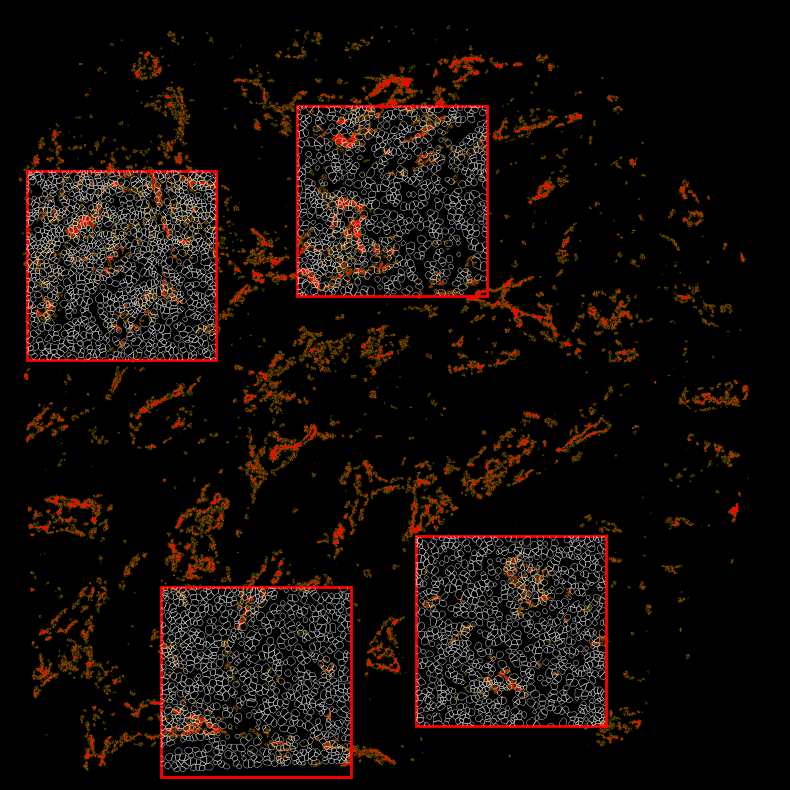

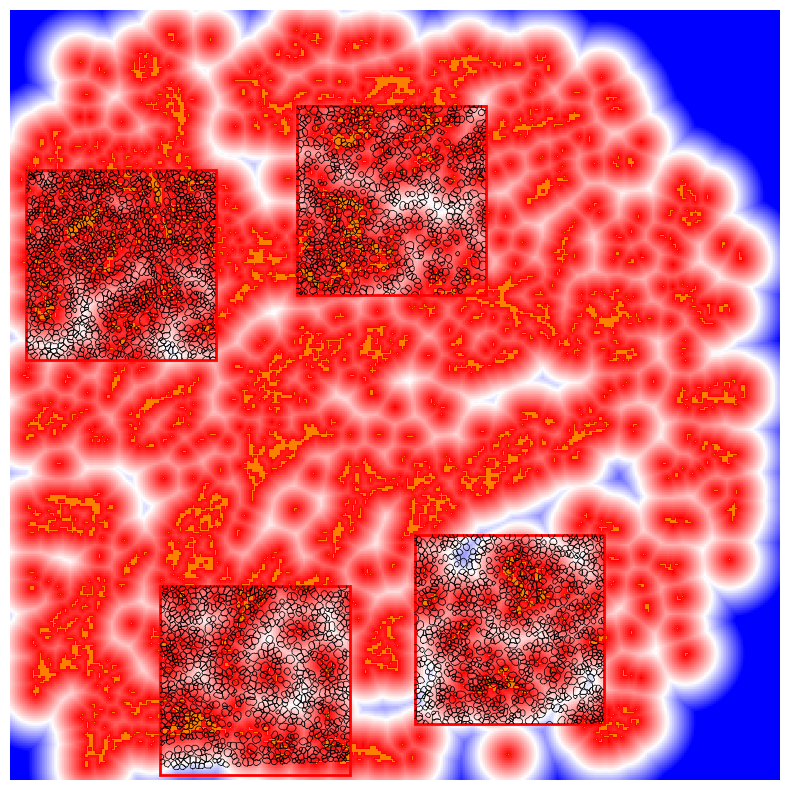

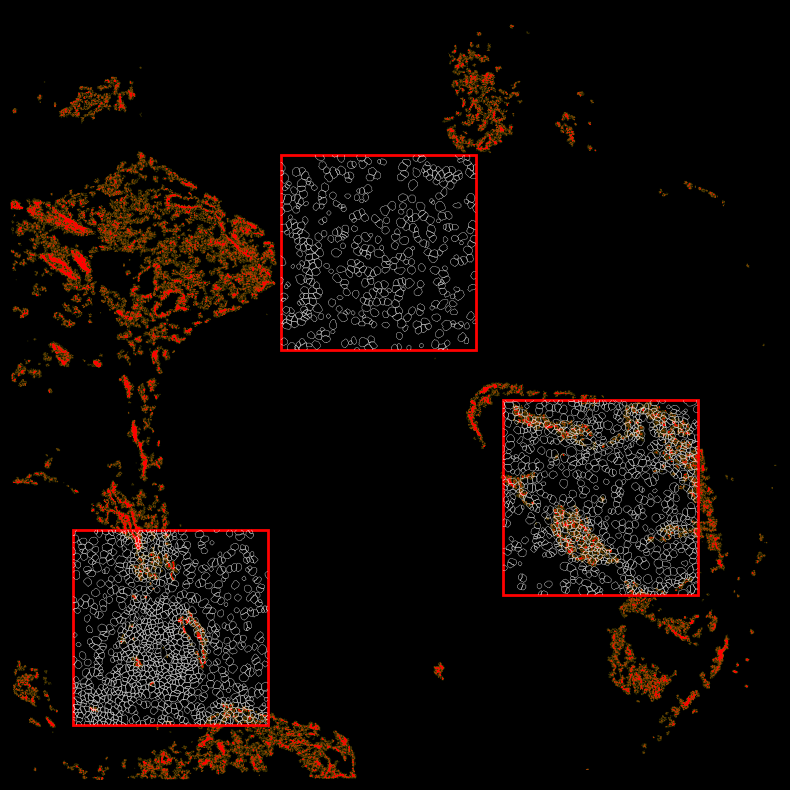

...

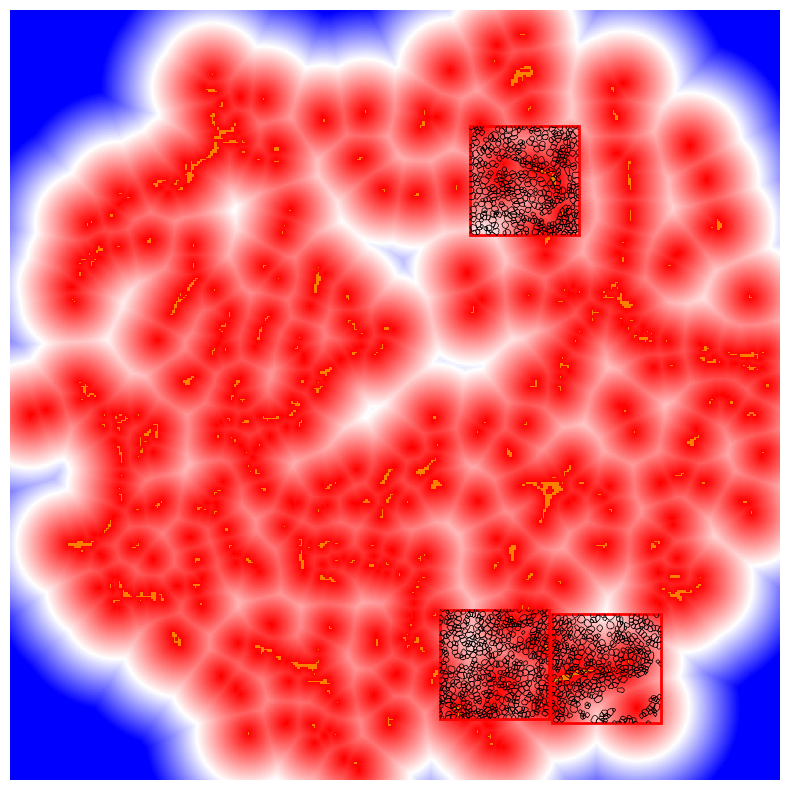

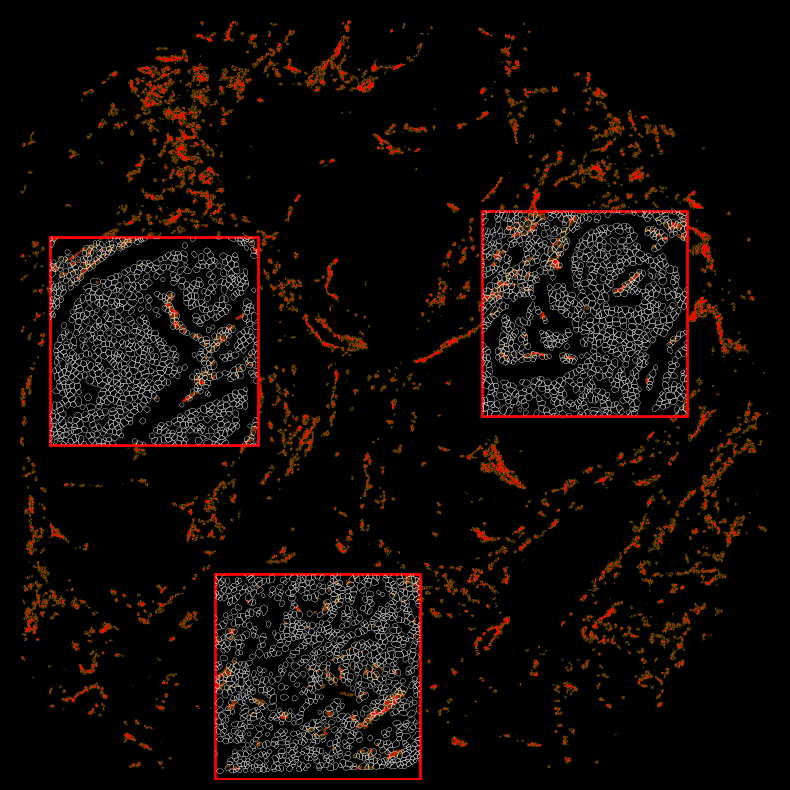

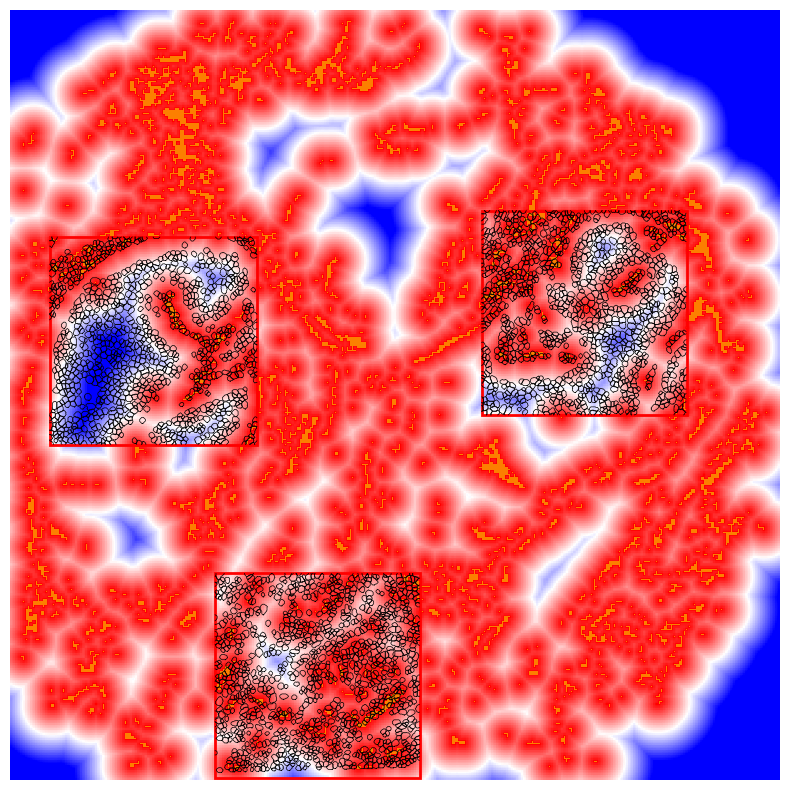

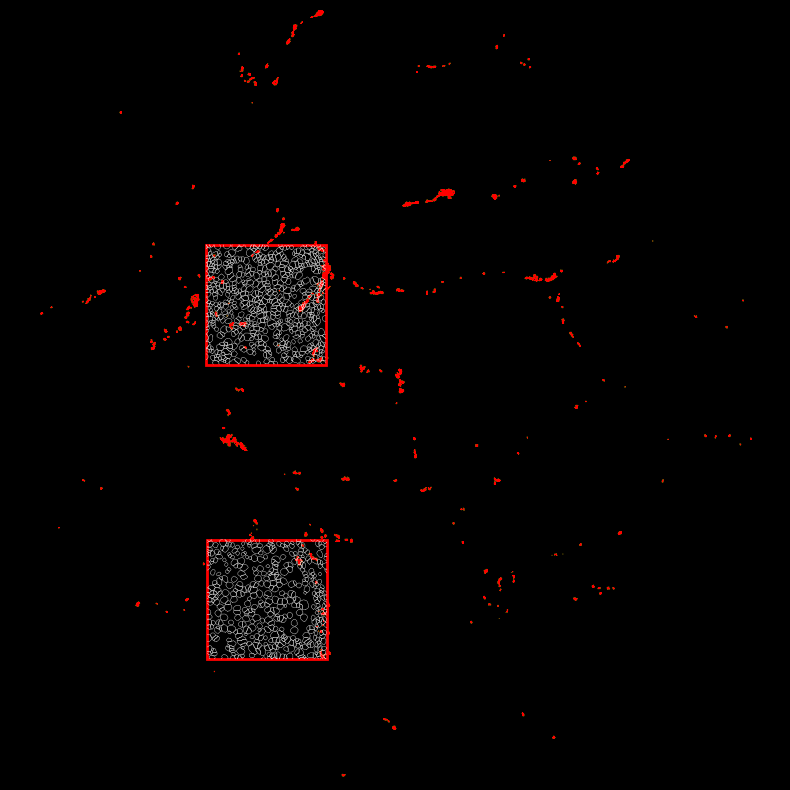

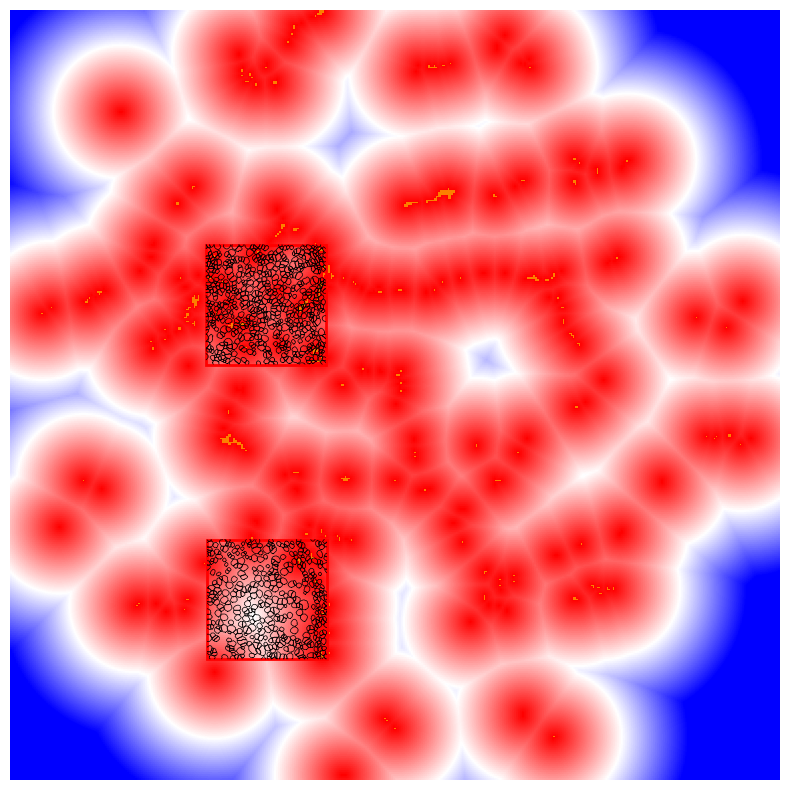

In [28]:
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

subset_lung = ["HistoneH3", 'DNA1', 'DNA2']
cores = ["B5", "C6", "D4", "E4", 'E6', "F4", "F7"]

# Choose colormap
cmap = pl.cm.autumn_r
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

cmap = pl.cm.gray
my_cmap2 = cmap(np.arange(cmap.N))
my_cmap2[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap2 = ListedColormap(my_cmap2)

size = 5
thresh = 0.05

for core in cores:
    datasets = [f'{core}_{i}' for i in range(1,5)]
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        imgs, markers = get_imgs(f"{experiment} {core}", "IMC")
        
        img_dapi = np.max(contrast_stretching(imgs[[markers.index(marker) for marker in subset_lung]]), axis=0)
        img_dapi = contrast_stretching(img_dapi, p_max=99.9)
        img = contrast_stretching(imgs[markers.index('CD31')], p_min=0, p_max=100)
        # img = imgs[markers.index('CD31')]
        try:
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            
            rotation = info["rotation_init"]
            border = info["border"]
            
            img_dapi = rotate(img_dapi, rotation, resize=True)
            img_dapi = cv2.copyMakeBorder(
                img_dapi, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            img = rotate(img, rotation, resize=True)
            img = cv2.copyMakeBorder(
                img, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            break
        except:continue
    
    fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
    # ax.imshow(img_dapi, cmap=my_cmap2)
    v_max = np.percentile(img, 99)
    v_max = 0.1 if v_max == 0 else v_max
    ax.imshow(img, vmax=v_max, cmap=my_cmap)
    ax.axis("off")
    
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        try:
            # Get temple matching coordinates
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            y, h_region, x, w_region = info["bbox"]

            # highlight matched region
            rect = plt.Rectangle(
                (x, y), w_region, h_region, edgecolor="r", facecolor="none", lw=2
            )
            ax.add_patch(rect)
            
            # Get mask and contour
            mask = masks["_".join([experiment, dataset])]
            contours = get_contour(mask)
            for j, contour in enumerate(contours):
                ax.plot(contour[:, 1]+x, contour[:, 0]+y, linewidth=0.25, color="white")
        except:continue
        


    # Get average marker image
    reduced, img_mean = mean_block(img, size)
    img_pos = reduced > thresh
    img_mean_pos = img_mean > thresh

    distance_img = get_distance(img_pos)
    distance_img = repeat_img(distance_img , size, img_mean.shape)
    
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(distance_img, cmap='bwr_r', vmin=0, vmax=np.percentile(distance_img, 95))
    ax.imshow(np.where(img_mean_pos, 1, np.nan), cmap='Wistia', alpha=1, vmax=1, vmin=0)
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        try:
            # Get temple matching coordinates
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            y, h_region, x, w_region = info["bbox"]

            # highlight matched region
            rect = plt.Rectangle(
                (x, y), w_region, h_region, edgecolor="r", facecolor="none", lw=2
            )
            ax.add_patch(rect)
            
            # Get mask and contour
            mask = masks["_".join([experiment, dataset])]
            contours = get_contour(mask)
            for j, contour in enumerate(contours):
                ax.plot(contour[:, 1]+x, contour[:, 0]+y, linewidth=0.5, color="k")
        except:continue
    ax.axis('off')
    plt.show()
    

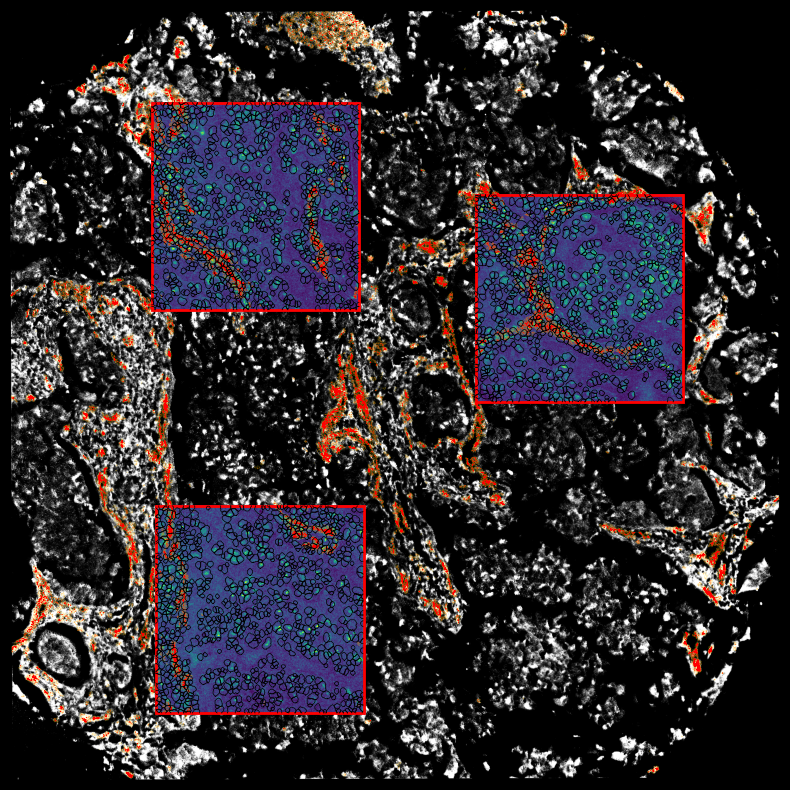

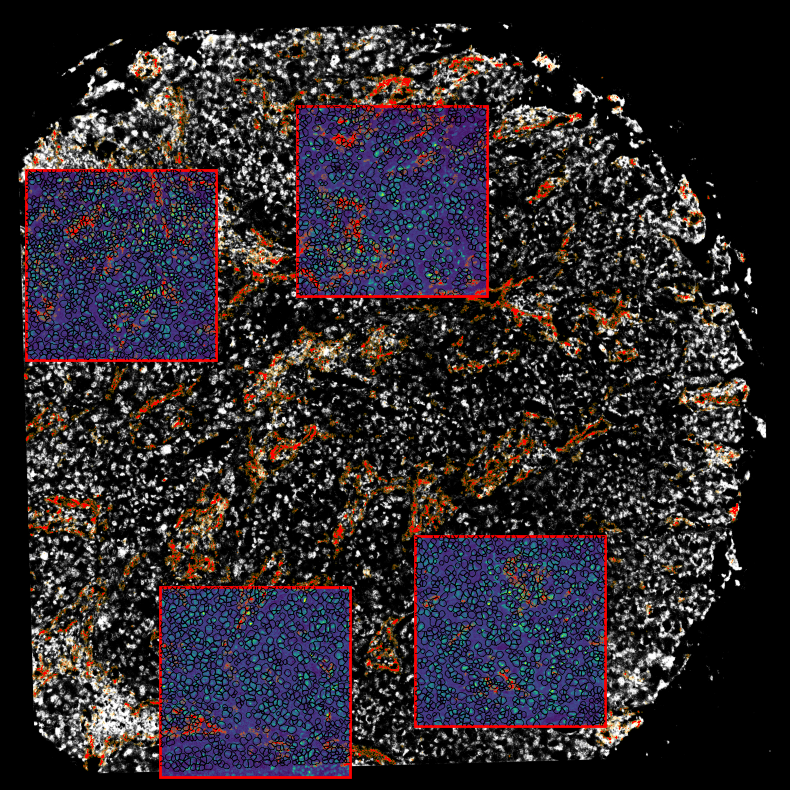

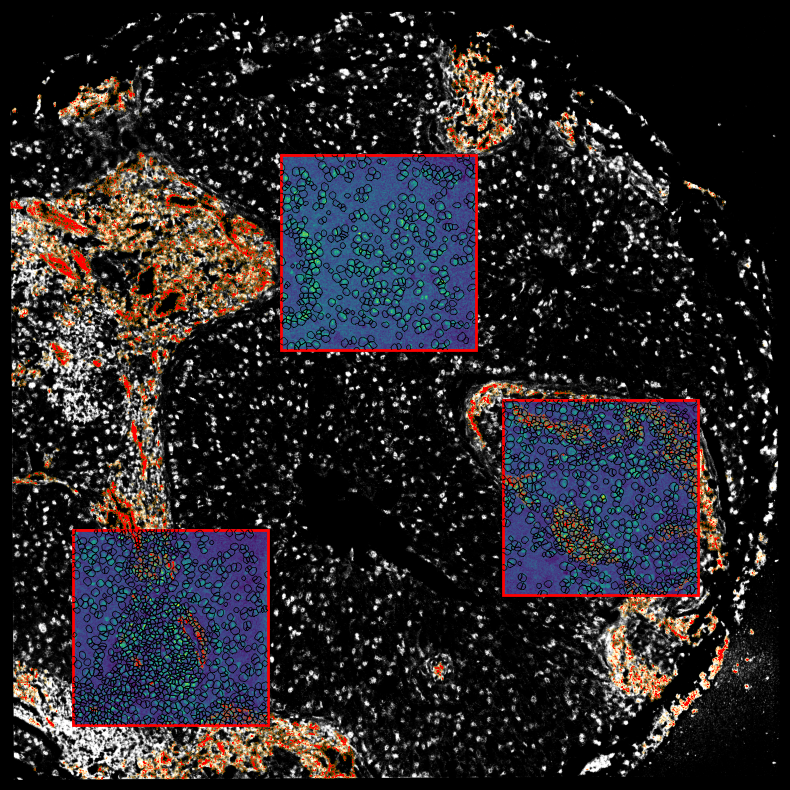

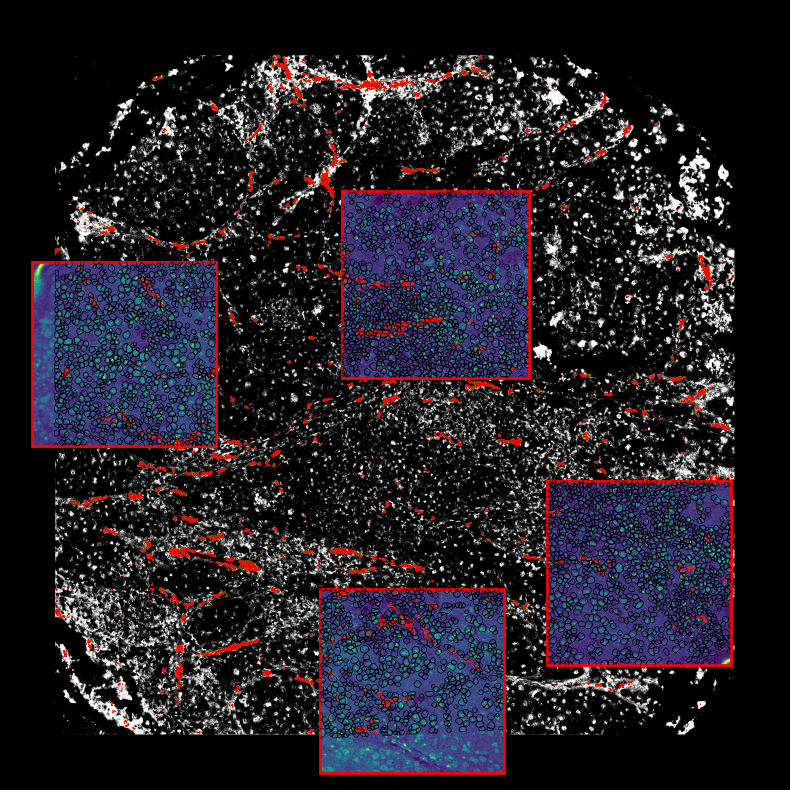

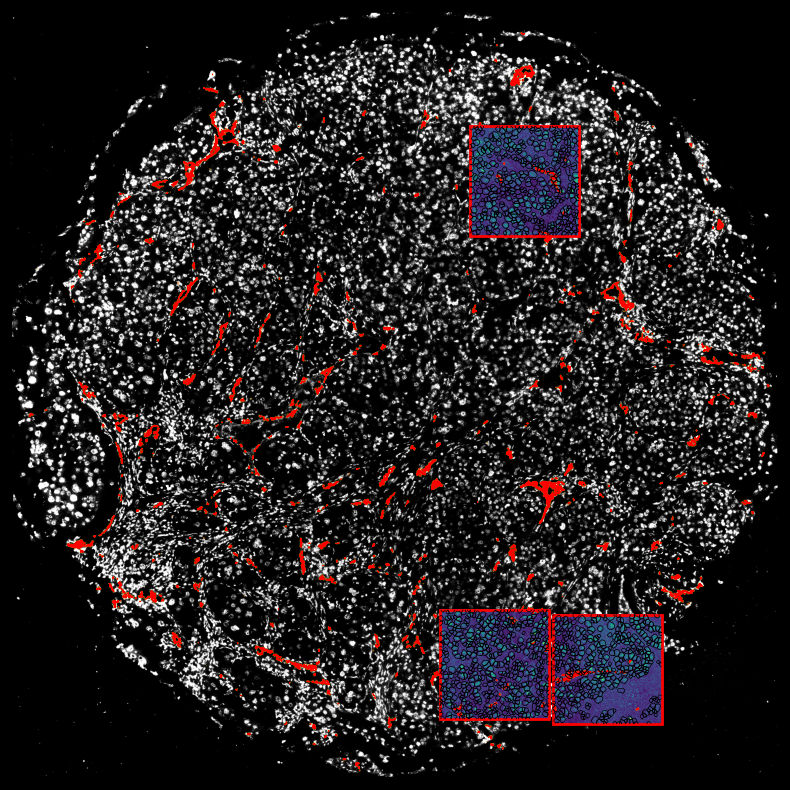

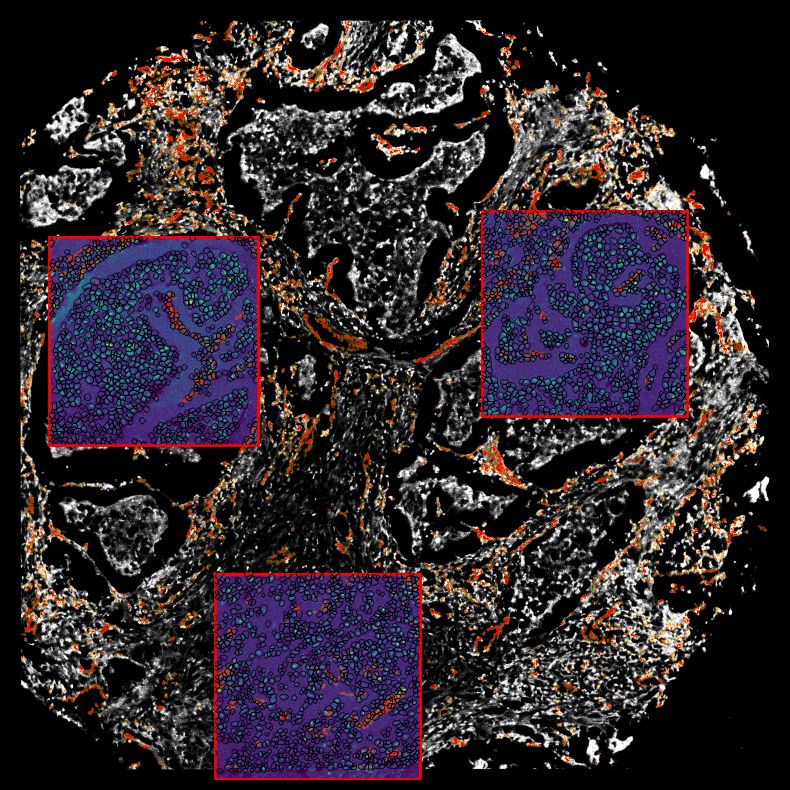

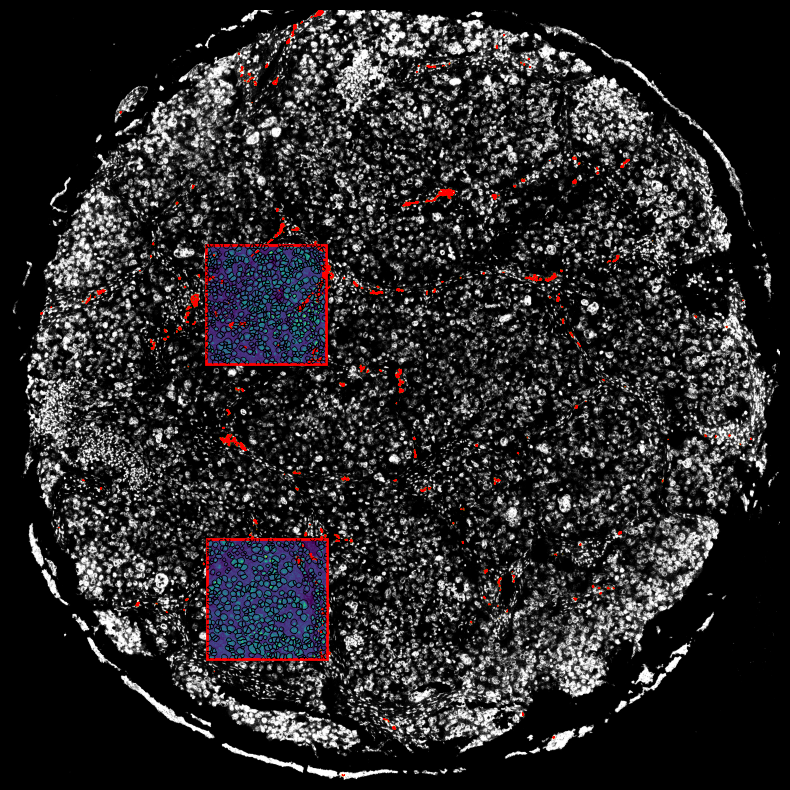

In [29]:
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

subset_lung = ["HistoneH3", 'DNA1', 'DNA2']
cores = ["B5", "C6", "D4", "E4", 'E6', "F4", "F7"]

# Choose colormap
cmap = pl.cm.autumn_r
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

cmap = pl.cm.gray
my_cmap2 = cmap(np.arange(cmap.N))
my_cmap2[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap2 = ListedColormap(my_cmap2)

size = 2
thresh = 0.01

for core in cores:
    datasets = [f'{core}_{i}' for i in range(1,5)]
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        imgs, markers = get_imgs(f"{experiment} {core}", "IMC")
        
        img_dapi = np.max(contrast_stretching(imgs[[markers.index(marker) for marker in subset_lung]]), axis=0)
        img_dapi = contrast_stretching(img_dapi, p_max=99.9)
        img = contrast_stretching(imgs[markers.index('CD31')], p_min=0, p_max=100)
        # img = imgs[markers.index('CD31')]
        try:
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            
            rotation = info["rotation_init"]
            border = info["border"]
            
            img_dapi = rotate(img_dapi, rotation, resize=True)
            img_dapi = cv2.copyMakeBorder(
                img_dapi, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            img = rotate(img, rotation, resize=True)
            img = cv2.copyMakeBorder(
                img, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            break
        except:continue
    
    fig, ax = plt.subplots(figsize=(10, 10), facecolor='k')
    ax.imshow(img_dapi, cmap=my_cmap2)
    v_max = np.percentile(img, 99)
    v_max = 0.1 if v_max == 0 else v_max
    ax.axis("off")
    
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        try:
            # Get temple matching coordinates
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            y, h_region, x, w_region = info["bbox"]

            # highlight matched region
            rect = plt.Rectangle(
                (x, y), w_region, h_region, edgecolor="r", facecolor="none", lw=2
            )
            ax.add_patch(rect)
            
            # Get mask and contour
            mask = masks["_".join([experiment, dataset])]
            contours = get_contour(mask)
            for j, contour in enumerate(contours):
                ax.plot(contour[:, 1]+x, contour[:, 0]+y, linewidth=0.5, color="k")
                
            imgs_sims, labels = get_imgs_sims(experiment, dataset)
            img_nuclei_downscale = get_imgs_index(imgs_sims, [18,32], fov_dim=h_region)
            ax.imshow(img_nuclei_downscale, extent=(x, x + w_region, y + h_region, y))
            
        except:continue
    ax.set_xlim(0, img_dapi.shape[1])
    ax.set_ylim(img_dapi.shape[0], 0)
    ax.imshow(img, vmax=v_max, cmap=my_cmap)

    

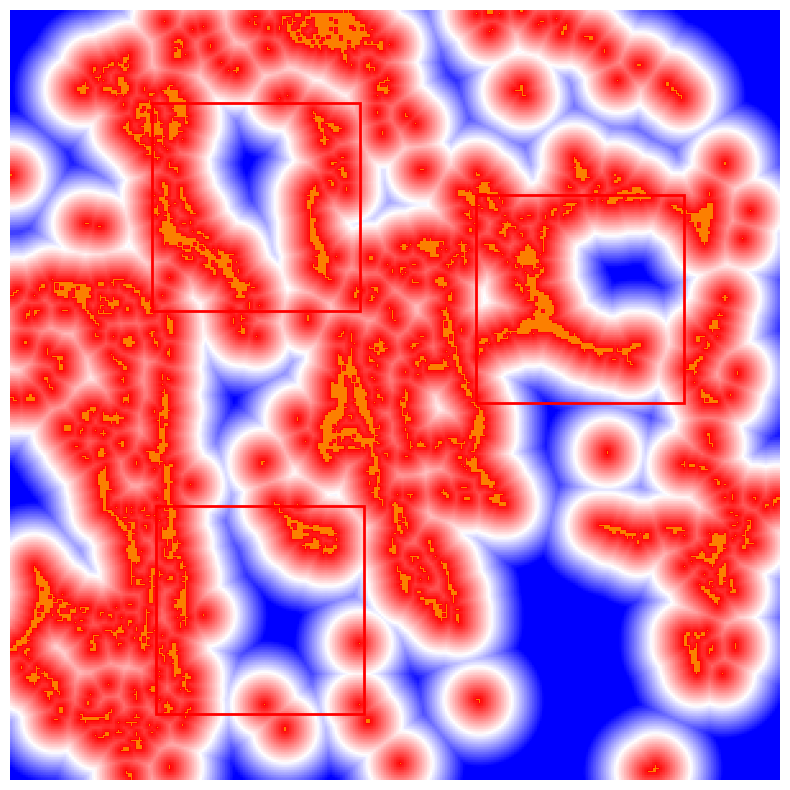

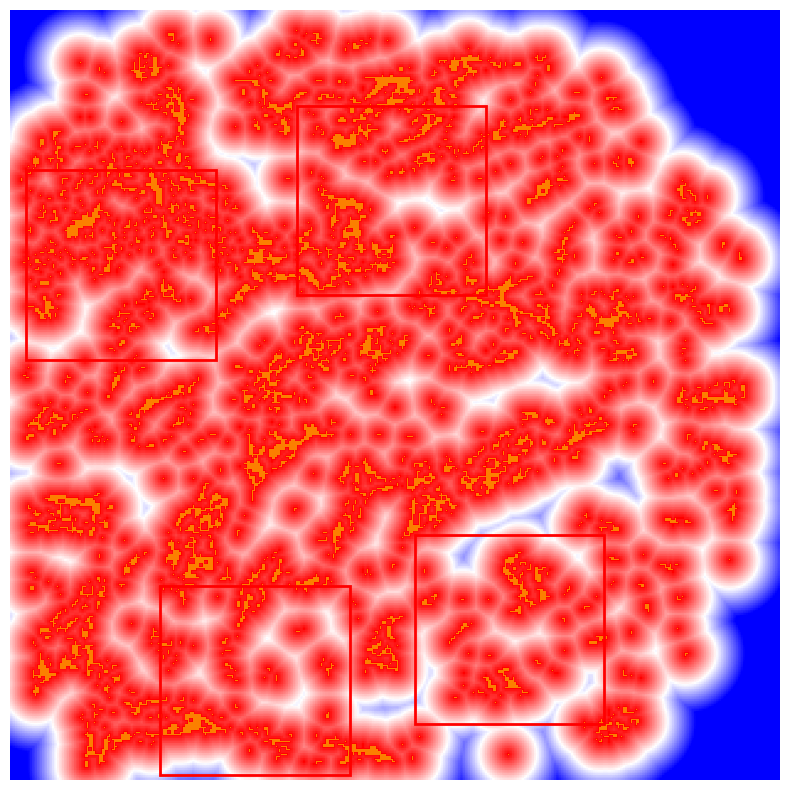

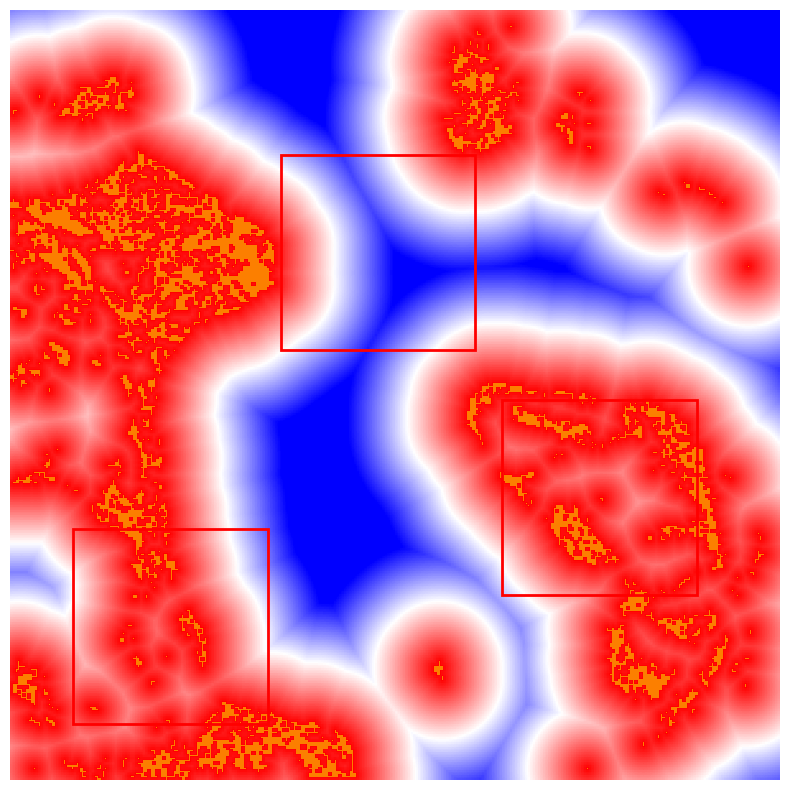

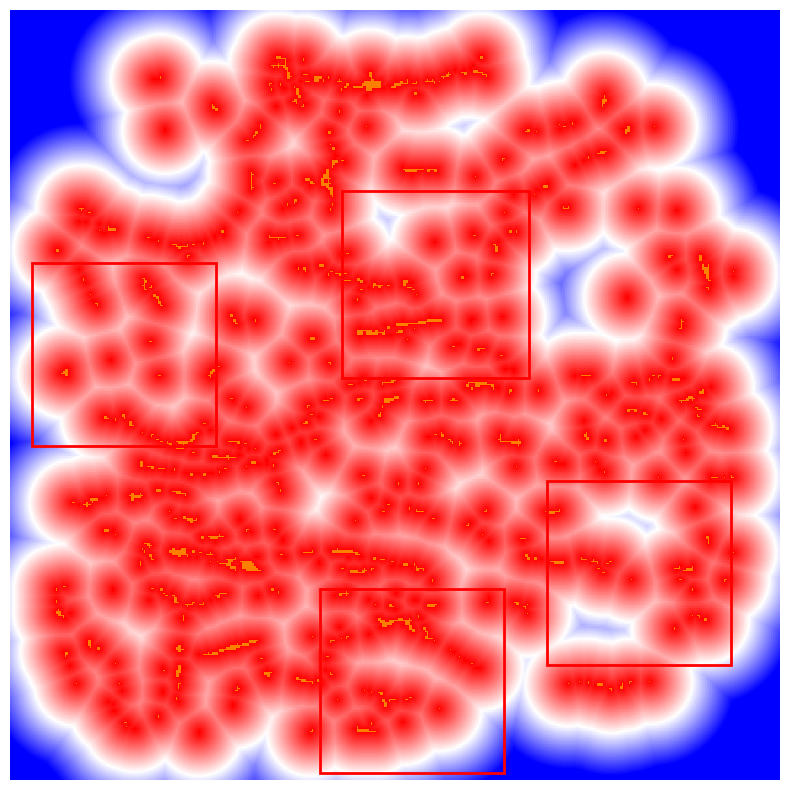

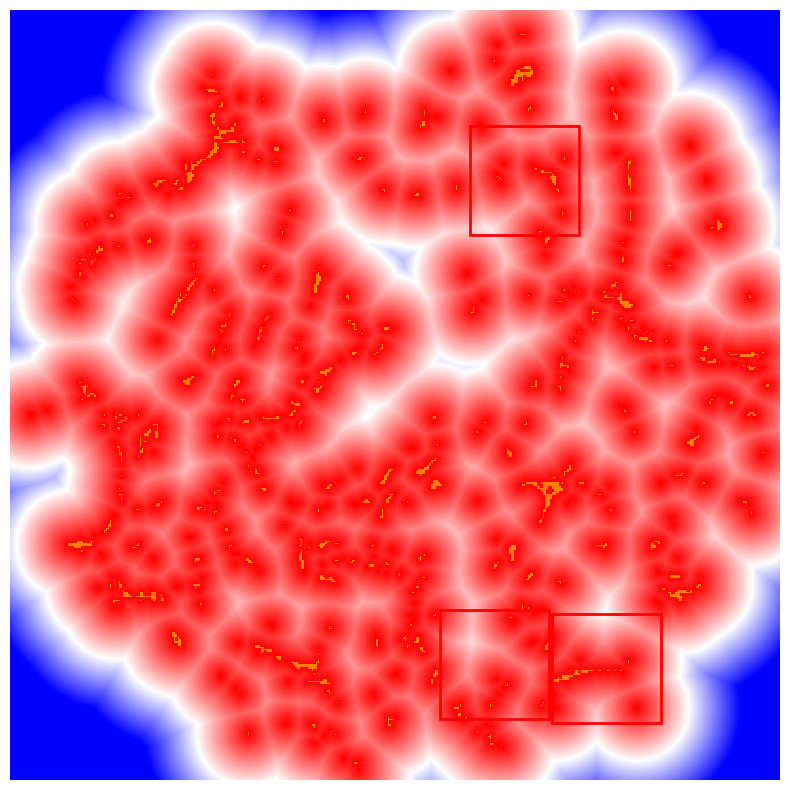

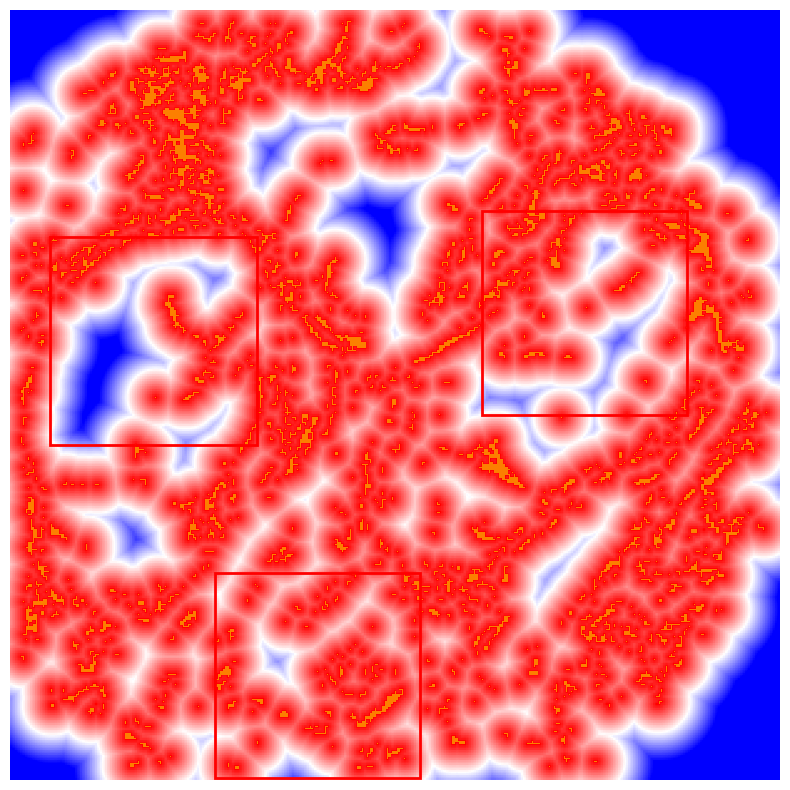

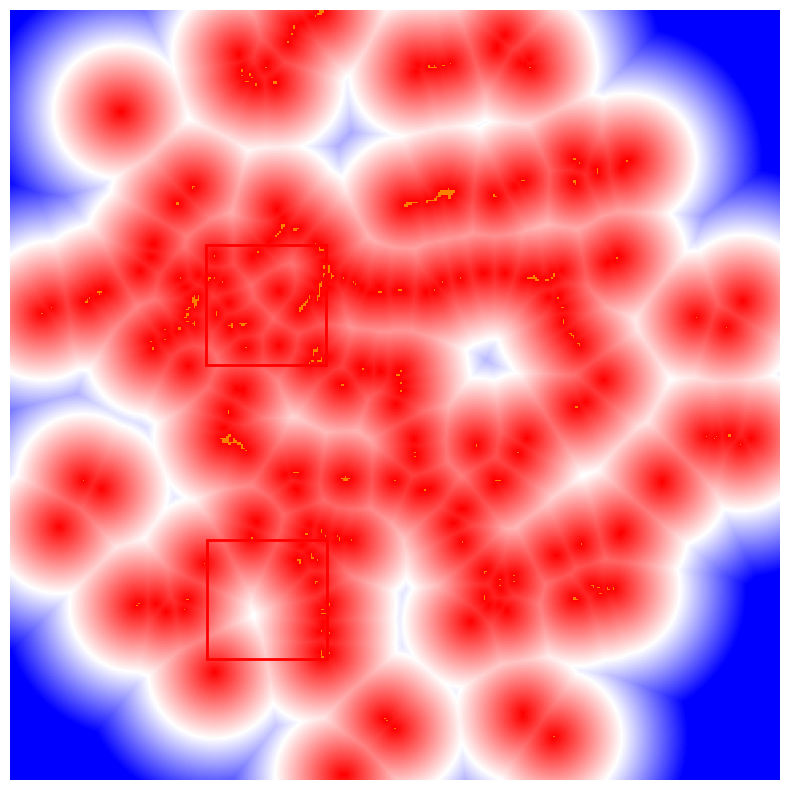

In [30]:
# Extract distance to CD31 from whole image
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

subset_lung = ["HistoneH3", 'DNA1', 'DNA2']
cores = ["B5", "C6", "D4", "E4", 'E6', "F4", "F7"]

# Save path
cd31_path = data_dir / 'CD31_distance'

# Choose colormap
cmap = pl.cm.autumn_r
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap = ListedColormap(my_cmap)

cmap = pl.cm.gray
my_cmap2 = cmap(np.arange(cmap.N))
my_cmap2[:,-1] = np.linspace(0, 1, cmap.N)
my_cmap2 = ListedColormap(my_cmap2)

size = 5
thresh = 0.05

for core in cores:
    datasets = [f'{core}_{i}' for i in range(1,5)]
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        imgs, markers = get_imgs(f"{experiment} {core}", "IMC")
        img = contrast_stretching(imgs[markers.index('CD31')], p_min=0, p_max=100)
        try:
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            
            rotation = info["rotation_init"]
            border = info["border"]

            img = rotate(img, rotation, resize=True)
            img = cv2.copyMakeBorder(
                img, border, border, border, border, cv2.BORDER_CONSTANT, None, value=0
            )
            break
        except:continue



    # Get average marker image
    reduced, img_mean = mean_block(img, size)
    img_pos = reduced > thresh
    img_mean_pos = img_mean > thresh

    distance_img = get_distance(img_pos)
    distance_img = repeat_img(distance_img , size, img_mean.shape)
    
    fig, ax = plt.subplots(figsize=(10,10))
    ax.imshow(distance_img, cmap='bwr_r', vmin=0, vmax=np.percentile(distance_img, 95))
    ax.imshow(np.where(img_mean_pos, 1, np.nan), cmap='Wistia', alpha=1, vmax=1, vmin=0)
    for i, dataset in enumerate(datasets): 
        if dataset in ['F7_1', 'F7_2']:
            continue 
        try:
            # Get temple matching coordinates
            info = my_utils.load_pkl(match_info_dir / f"{experiment}_{dataset}.pickle")
            y, h_region, x, w_region = info["bbox"]

            # highlight matched region
            rect = plt.Rectangle(
                (x, y), w_region, h_region, edgecolor="r", facecolor="none", lw=2
            )
            ax.add_patch(rect)
            
            # Get mask and contour
            mask = masks["_".join([experiment, dataset])]
            
            df = pd.DataFrame(measure.regionprops_table(mask, distance_img[y:y+h_region, x:x+w_region], 
                                                        properties=['label', 'mean_intensity']))
            df.to_csv(cd31_path / f'{dataset}.csv', index=False)
        except:continue
    ax.axis('off')
    plt.show()


# Combine with sims data

In [31]:
from sklearn.preprocessing import MinMaxScaler

# Save path
cd31_path = data_dir / 'CD31_distance'

scaler = MinMaxScaler()
adatas = []
adatas_SIMS = []

for dataset in adata_IMC.obs['Dataset'].unique():
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == dataset]
    adata_fov_sims = adata[adata.obs['Dataset'] == dataset]
    
    distance_df = pd.read_csv(cd31_path / f'{dataset}.csv')
    distance_df.columns = ['Cell', 'Proximity to CD31']
    
    df_merged = adata_fov_sims.obs.merge(distance_df, left_on='Cell', right_on='Cell')
    adata_fov_sims.obs = df_merged 
    print(df_merged.isnull().values.any())
    
    df_merged = adata_fov.obs.merge(distance_df, left_on='Cell', right_on='Cell')
    adata_fov.obs = df_merged 
    adatas.append(adata_fov)
    adatas_SIMS.append(adata_fov_sims)

C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inf

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False


C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inf

In [32]:
adata_distance = ad.concat(adatas_SIMS)

df = pd.DataFrame(adata_distance.X, columns=adata_distance.var_names.tolist())
d = np.array(adata_distance.obs['Proximity to CD31'].tolist()).reshape(-1, 1)
d = scaler.fit_transform(d)
d = d.flatten()
df['Proximity to CD31'] = d

df_corr = df.corr()


C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [33]:
df

,12.0m/z,13.0m/z,14.0m/z,16.0m/z,17.0m/z,19.0m/z,22.6m/z,24.0m/z,25.0m/z Lipid,26.0m/z Lipid,...,200.9m/z,204.9m/z Hydroquinone,208.9m/z Lipid,210.0m/z,216.9m/z,228.9m/z,233.9m/z,242.9m/z,253.3m/z FA(16:1),Proximity to CD31
0,0.591622,2.158175,0.316850,-0.645163,-0.610622,0.596492,0.609595,0.260588,0.735190,-1.290381,...,-0.846558,1.506737,0.371284,2.632912,0.070675,0.411407,1.791936,1.295917,2.743258,0.019712
1,-1.067874,0.185717,0.426488,-0.446662,-0.512566,0.521843,0.194259,-0.460121,0.172409,-0.842892,...,2.303787,1.208951,0.307367,0.569316,1.482183,0.620328,1.526229,0.782795,1.754725,0.021389
2,-0.532839,-0.039789,0.685199,-0.498451,-0.491598,-0.038949,0.166144,-0.301323,0.077583,-0.108244,...,-0.763384,0.381897,0.892743,0.167096,0.744170,-0.392500,-0.322025,0.146462,-0.386299,0.000394
3,-0.354440,-0.823069,-0.151473,-0.335768,-0.459936,0.402167,-0.016601,-0.653612,-0.973065,0.314979,...,0.096935,0.093631,-0.088940,0.129570,-0.273030,-0.045550,1.354327,0.921442,1.127732,0.152600
4,-0.180184,-0.309185,-0.405262,-0.143090,-0.516805,-0.161172,-0.127325,0.125449,-0.916097,0.634417,...,-1.574924,0.677583,-0.182912,0.192548,0.117749,-0.242618,-0.131853,-0.176906,0.028821,0.081965
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19502,-0.265544,-0.365268,-0.612009,-0.131938,-0.555519,0.762198,0.412400,-0.323526,-0.351064,0.820815,...,-0.164475,-0.096968,1.062182,-0.880236,0.460019,-0.726107,0.545114,-0.292355,0.090262,0.146647
19503,0.937511,-0.033650,-0.009603,0.304596,0.044113,-0.026632,-0.625342,0.624633,-0.036274,0.034839,...,0.347909,0.472209,-0.888064,-0.726142,0.162574,1.101485,-0.385196,0.346558,3.077902,0.187090
19504,-0.131222,0.070721,0.588941,0.531265,-0.087104,-0.070346,-0.563821,-0.192629,-0.043857,-0.515975,...,0.619783,0.149406,0.678703,0.195812,-0.103287,2.130363,-0.639495,-0.599511,0.976984,0.187949
19505,-0.847208,0.254438,0.616906,0.405249,0.033823,-0.732560,-0.877710,-1.120834,-0.199161,-0.693779,...,1.179630,-0.081636,-0.905463,0.018109,-0.360614,-0.317408,-0.412026,0.722474,0.120862,0.171898


## Plot metabolites to distance correlation

In [34]:
from sklearn.preprocessing import LabelEncoder
import seaborn as sns

In [35]:
n = 8
marker = 'Proximity to CD31'
n_cut = 25

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

LE = LabelEncoder()
df_intensity[f'{marker} cut'] = LE.fit_transform(df_intensity[f'{marker} cut'])

C:\Users\thu71\AppData\Local\Temp\ipykernel_564\1028058216.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_intensity.sort_values(by=[marker], inplace=True)
C:\Users\thu71\AppData\Local\Temp\ipykernel_564\1028058216.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop')
C:\Users\thu71\AppData\Local\Temp\ipykernel_564\1028058216.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value

In [36]:
df_sort = df_intensity.groupby('Proximity to CD31 cut').median()

adata_cd31_corr = sc.AnnData(df_sort.iloc[:,1:])
adata_cd31_corr.var_names = df_sort.iloc[:,1:].columns.tolist()
# adata_cd31_corr.obs['Proximity'] = df_sort.iloc[:,1].values
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


C:\Users\thu71\Anaconda3\envs\traj\lib\site-packages\scanpy\plotting\_anndata.py:2414: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


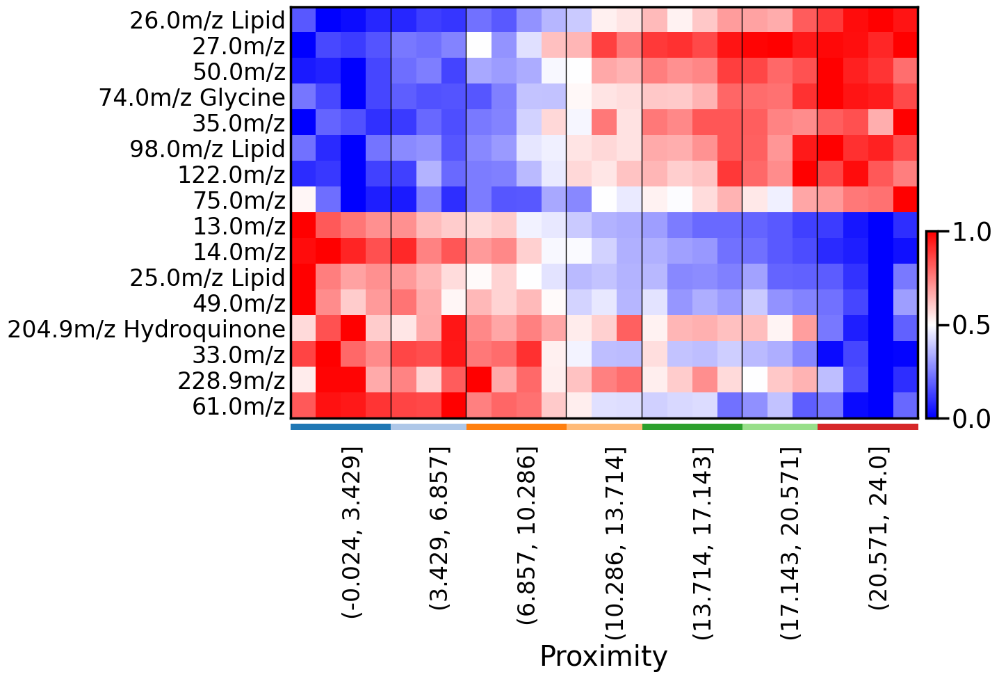

In [37]:
with sns.plotting_context('poster', font_scale=1.2):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,8), standard_scale='var')

## Additional plot 

In [38]:
from scipy import stats
import sklearn.metrics


In [39]:
df_sort.head()

,Proximity to CD31,26.0m/z Lipid,27.0m/z,50.0m/z,74.0m/z Glycine,35.0m/z,98.0m/z Lipid,122.0m/z,75.0m/z,13.0m/z,14.0m/z,25.0m/z Lipid,49.0m/z,204.9m/z Hydroquinone,33.0m/z,228.9m/z,61.0m/z
Proximity to CD31 cut,,,,,,,,,,,,,,,,,
0,0.001531,-0.137433,-0.377964,-0.213227,-0.114778,-0.250843,-0.158753,-0.231350,0.217437,0.321102,0.138571,0.339524,0.238373,-0.067943,0.057157,-0.107052,-0.111819
1,0.008118,-0.286211,-0.280610,-0.204166,-0.168108,-0.132952,-0.242689,-0.219381,0.088578,0.166674,0.153887,0.133829,0.070076,0.049192,0.107458,0.070821,-0.069052
2,0.013615,-0.264500,-0.296698,-0.246700,-0.254592,-0.155141,-0.292704,-0.279682,-0.005723,0.119301,0.106840,0.078451,-0.008192,0.119753,0.030998,0.071999,-0.072387
3,0.019586,-0.221632,-0.265622,-0.160152,-0.171138,-0.192879,-0.154947,-0.209497,0.019614,0.076118,0.051224,0.104955,0.053800,-0.055998,0.004974,-0.056858,-0.089433
4,0.025845,-0.221455,-0.218458,-0.111410,-0.142641,-0.180909,-0.129405,-0.211014,0.016287,0.074061,0.102750,0.090169,0.097580,-0.078132,0.054984,-0.026769,-0.098577


Text(0.02, 0.5, 'Metabolite')

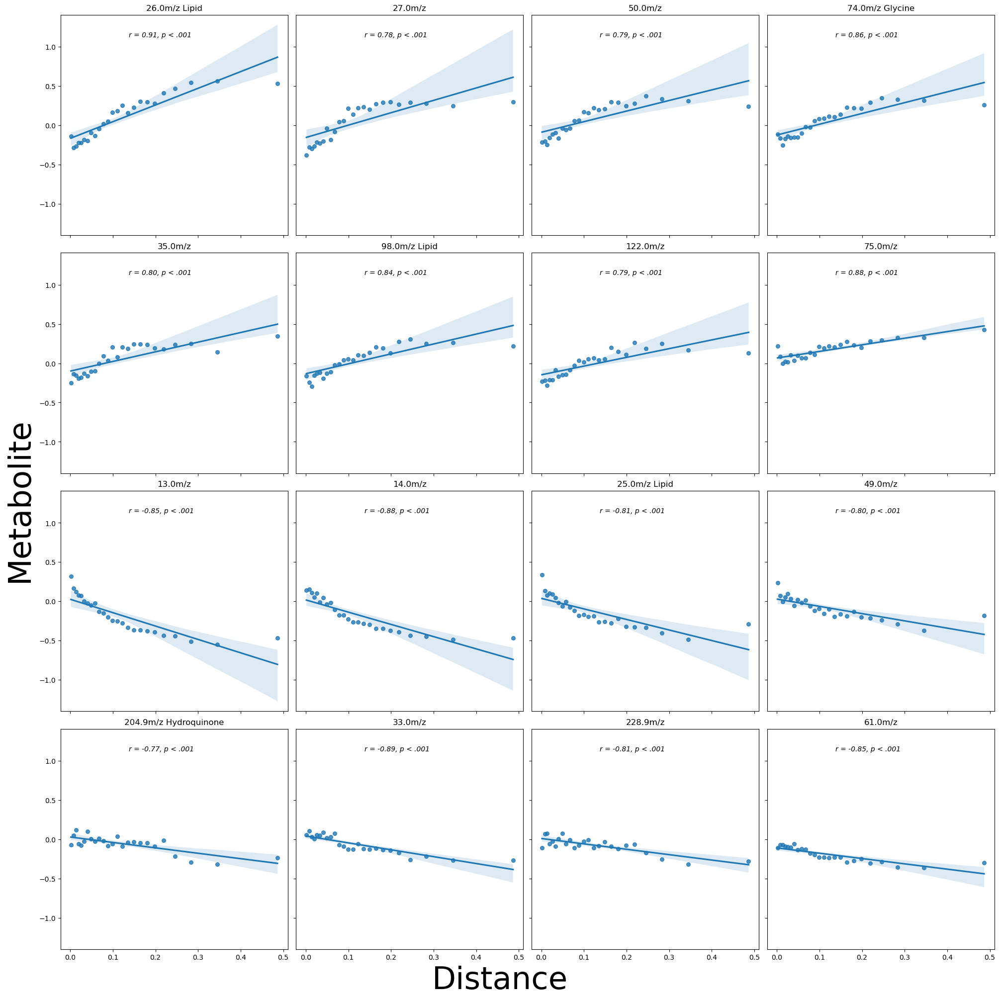

In [40]:
df_corr = df_sort

fig, axs = plt.subplots(4,4, figsize=(20,20), sharex=True, sharey=True, constrained_layout=True)
distance = df_corr .iloc[:, 0].tolist()
name = df_corr.columns.tolist()

axs = axs.flatten()
for i, ax in enumerate(axs):
    channel = df_corr .columns[1+i]
    r_score,  p_value = stats.pearsonr(distance, df_corr [channel].tolist())

    reg = sns.regplot(x=distance, y=df_corr [channel].tolist(), ax=ax, scatter_kws={'s': 30})
    # reg.set(xlabel='Distance', ylabel='')
    reg.text(0.3, 0.9, f'r = {r_score:.2f}, p < .001', fontstyle='italic', transform=ax.transAxes)
    ax.set_title(name[1+i])
fig.supxlabel('Distance',fontsize=45)
fig.supylabel('Metabolite', fontsize=45)


## Plot example

In [41]:
# Plotting
def create_intensity_cell(mask, cell2intensity, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.float)*np.nan

    for cell, intensity in tqdm(cell2intensity.items(), total=len(cell2intensity)):
        rows, cols = np.where(np.isin(mask, cell))
        img[rows, cols] = intensity
    return img


  0%|          | 0/450 [00:00<?, ?it/s]

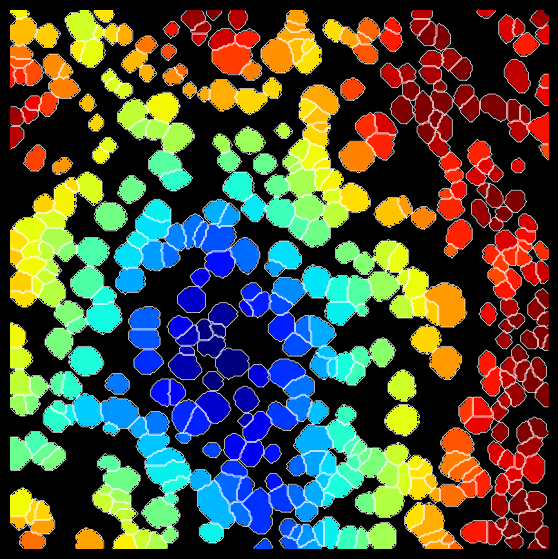

  0%|          | 0/645 [00:00<?, ?it/s]

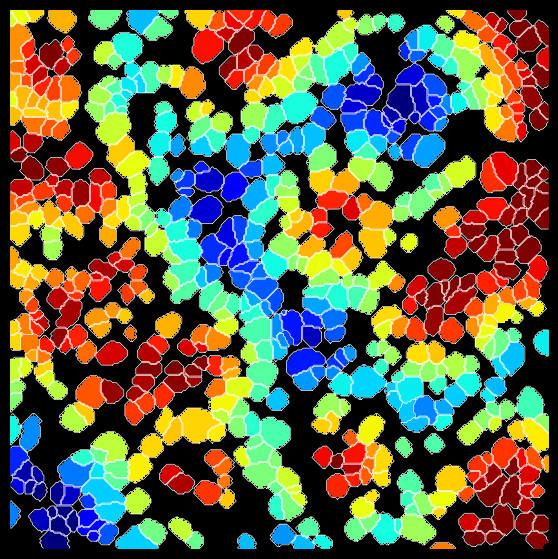

In [42]:
import warnings
warnings.filterwarnings('ignore')

attr = 'Type'
cmap_dist = 'jet_r'

for spl in datasets:
    # Get CD31 positif 
    adata_fov = adata_IMC[adata_IMC.obs['Dataset'] == spl]
    adata_ref = adata_fov[adata_fov[:,'CD31'].X > 0.05]

    # Get distance to CD31 positif cells for all cells
    try:
        distance_df = pd.read_csv(cd31_path / f'{spl}.csv')
        distance_df.columns = ['Cell', 'Proximity to CD31']
    except:
        continue
    label2cell = {}
    cell_ids = adata_fov.obs.Cell.to_list()

    for i, cell in enumerate(cell_ids):
        label2cell[cell] = distance_df.loc[distance_df.Cell == cell, 'Proximity to CD31'].item()
        
    # Get mask and contours
    mask = masks["_".join([experiment, spl])]
    contours = get_contour(mask)    

    img = create_intensity_cell(mask, label2cell)

    # Plot
    fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
    ax.imshow(img, cmap=cmap_dist, vmin=np.nanquantile(img, 0.05), vmax=np.nanquantile(img, 0.99), alpha=1)
    ax.axis("off")
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    plt.show()

In [43]:
# Plotting
def create_intensity_cell(mask, cell2intensity, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.float)*np.nan

    for cell, intensity in tqdm(cell2intensity.items(), total=len(cell2intensity)):
        rows, cols = np.where(np.isin(mask, cell))
        img[rows, cols] = intensity
    return img

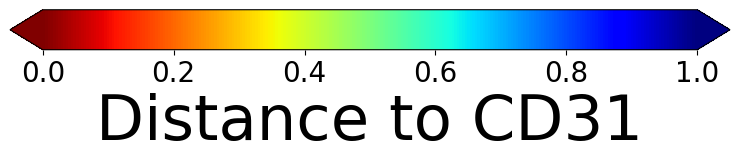

In [44]:
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(8, 4))
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.1])

norm = mpl.colors.Normalize(vmin=0, vmax=1)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax1, cmap='jet_r',
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'Distance to CD31', fontsize=45)


# Local competition with CD31 distane

In [45]:
# Import spatial omics library
import athena as ath
from spatialOmics import SpatialOmics

# import default graph builder parameters
from athena.graph_builder.constants import GRAPH_BUILDER_DEFAULT_PARAMS
from matplotlib.colors import ListedColormap

In [46]:
import networkx as nx
import numpy as np
import pandas as pd
from typing import List
import matplotlib
import skimage
from skimage import measure

def get_node_interactions(g: nx.Graph, data: pd.Series = None):
    # NOTE: The data pd.Series is categorical with globally all categories

    source, neighs = [], []
    for i in g.nodes:
        if len(g[i]) > 0:  # some nodes might have no neighbors
            source.append(i)
            neighs.append(list(g[i]))

    node_interactions = pd.DataFrame({'source': source, 'target': neighs}).explode('target')
    if data is not None:
        node_interactions['source_label'] = data.loc[node_interactions.source].values
        node_interactions['target_label'] = data.loc[node_interactions.target].values

    return node_interactions

def get_interaction_type(node_interactions: pd.DataFrame, interaction=('GC B-cell', 'FDC')):
    
    # Get rid of source == target rows
    nint = node_interactions[~(node_interactions.source == node_interactions.target)]
    
    # Only need to look at one interaction direction A->B because B->A will be symetric
    (a1, a2) = interaction
    nint_filtered1 = nint[(nint.source_label == a1) & (nint.target_label == a2)]
    nint_filtered2 = nint[(nint.source_label == a2) & (nint.target_label == a1)]
    return pd.concat([nint_filtered1, nint_filtered2])


# Plotting
def create_clustered_cell(mask, label2cell, my_cmap, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)

    for i, cells in tqdm(label2cell.items(), total=len(label2cell)):
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols, :] = my_cmap[int(i)]

    return img


def get_contour(mask: np.ndarray) -> List[List[float]]:
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours



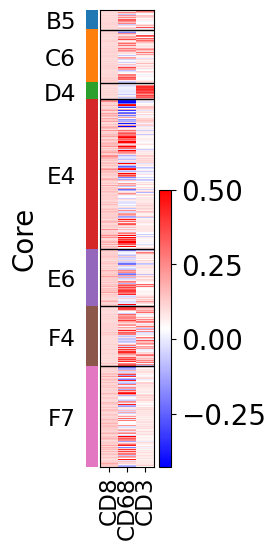

In [47]:
sc.pl.heatmap(adata_IMC[adata_IMC[:,'CD8'].X > 0.1], ['CD8', 'CD68', 'CD3'], groupby='Core', cmap='bwr', vmax=0.5)

In [82]:
type_new = adata_IMC.obs['Type'].to_numpy()
type_new[(adata_IMC[:,'CD3'].X > 0.1).flatten().tolist()] = 'CD3+'
adata_IMC.obs['Type_new'] = type_new
adata_IMC.obs['Type_new'] = adata_IMC.obs['Type_new'].astype('category')

In [83]:
# Create spatial omics data objects

spadata = SpatialOmics()
spl = pd.DataFrame({'Dataset': adata_IMC.obs.Dataset.unique()})
spadata.spl = spl

for d in adata_IMC.obs.Dataset.unique():
    adata_subset = adata_IMC[adata_IMC.obs.Dataset == d, :]
    
    obs = adata_subset.obs.copy()
    obs['x'] = adata_subset.obsm['spatial'][:,1].tolist()
    obs['y'] = adata_subset.obsm['spatial'][:,0].tolist()
    obs['cell_id'] = obs['Cell']
    obs = obs.set_index('cell_id')
    spadata.obs[d] = obs
    spadata.X[d] = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names, index=adata_subset.obs.Cell.tolist())
    spadata.var[d] = adata_subset.var
    spadata.masks[d] = {'cellmasks': masks["_".join([experiment, d])]}

In [84]:
# Loop through all region and create different cell neighborhood graph
datasets = spadata.spl.Dataset

for spl in datasets:
    # kNN graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['knn']
    config['builder_params']['n_neighbors'] = 5 # set parameter k
    ath.graph.build_graph(spadata, spl, builder_type='knn', mask_key='cellmasks', config=config)

    # Radius graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['radius']
    config['builder_params']['radius'] = 20 # set radius
    ath.graph.build_graph(spadata, spl, builder_type='radius', mask_key='cellmasks', config=config)


  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/937 [00:00<?, ?it/s]

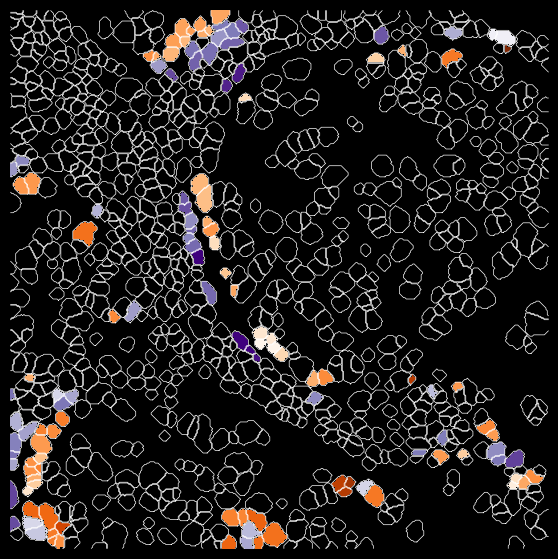

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/37 [00:00<?, ?it/s]

  0%|          | 0/960 [00:00<?, ?it/s]

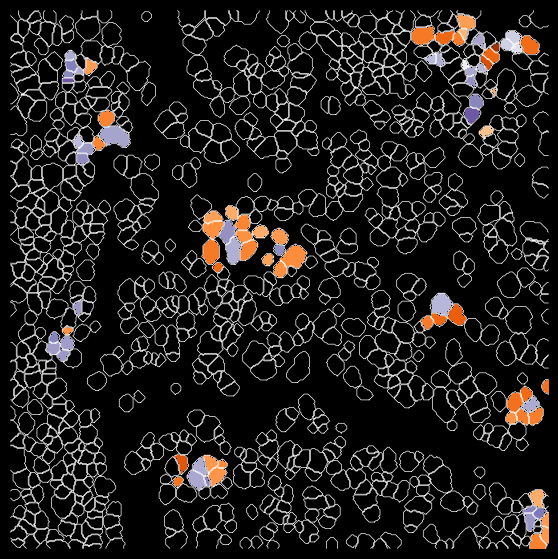

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

  0%|          | 0/993 [00:00<?, ?it/s]

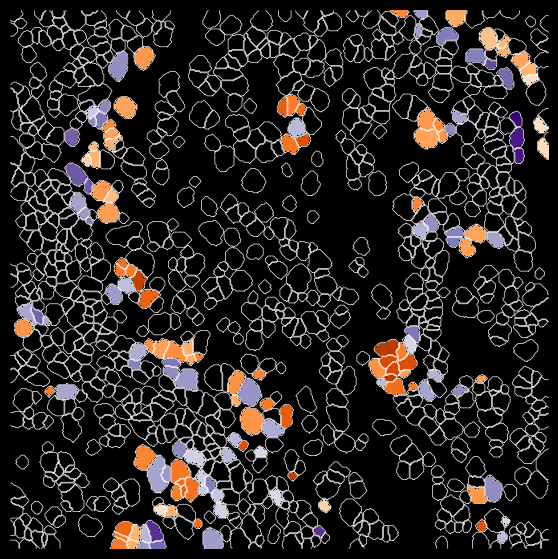

  0%|          | 0/70 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/905 [00:00<?, ?it/s]

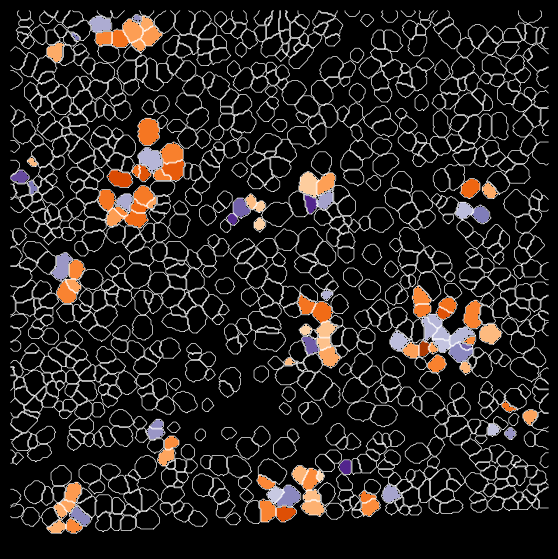

  0%|          | 0/123 [00:00<?, ?it/s]

  0%|          | 0/44 [00:00<?, ?it/s]

  0%|          | 0/970 [00:00<?, ?it/s]

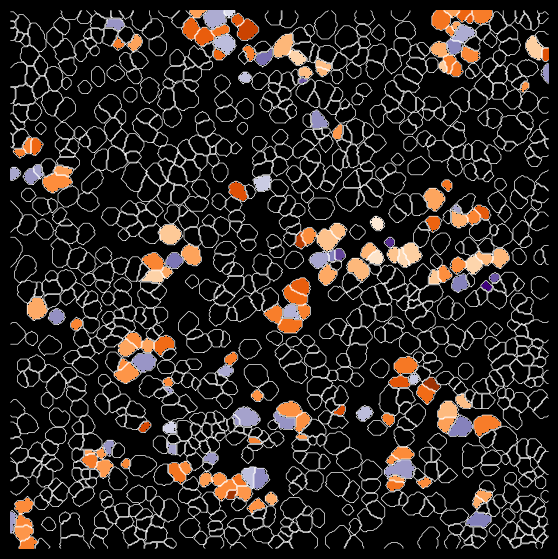

  0%|          | 0/95 [00:00<?, ?it/s]

  0%|          | 0/86 [00:00<?, ?it/s]

  0%|          | 0/1282 [00:00<?, ?it/s]

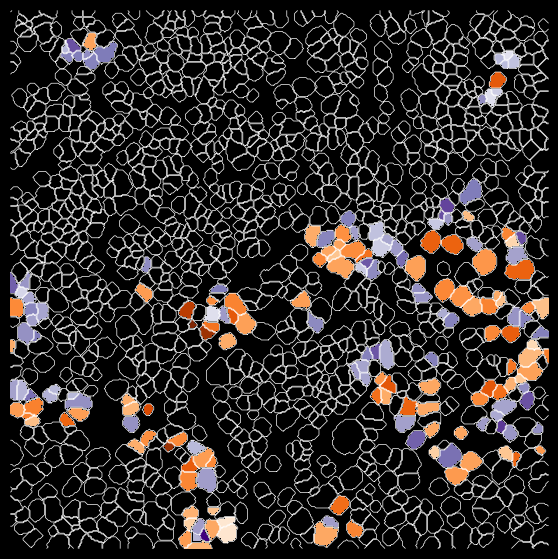

  0%|          | 0/60 [00:00<?, ?it/s]

  0%|          | 0/38 [00:00<?, ?it/s]

  0%|          | 0/866 [00:00<?, ?it/s]

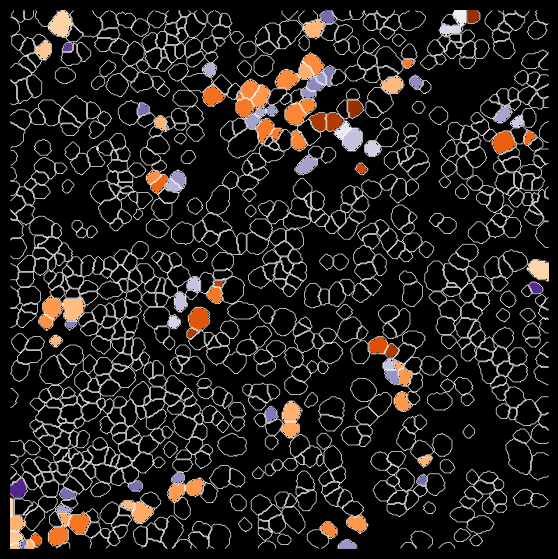

  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/54 [00:00<?, ?it/s]

  0%|          | 0/948 [00:00<?, ?it/s]

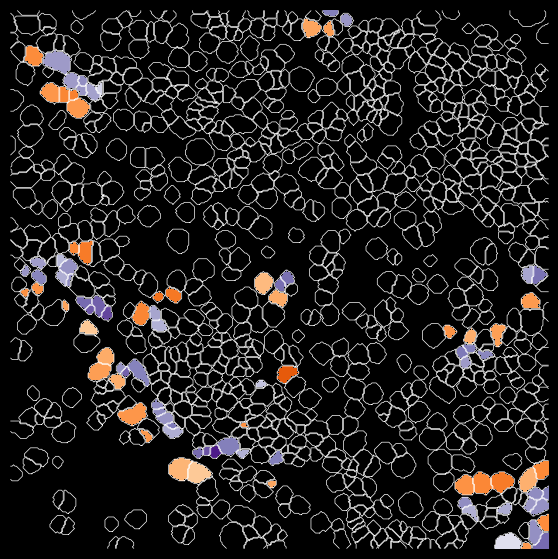

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/82 [00:00<?, ?it/s]

  0%|          | 0/1117 [00:00<?, ?it/s]

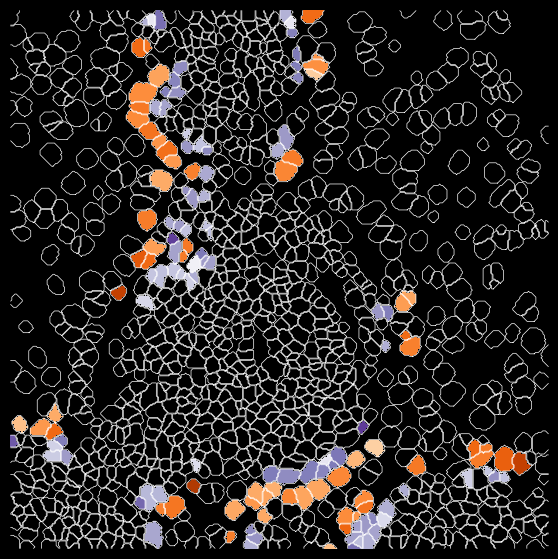

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/456 [00:00<?, ?it/s]

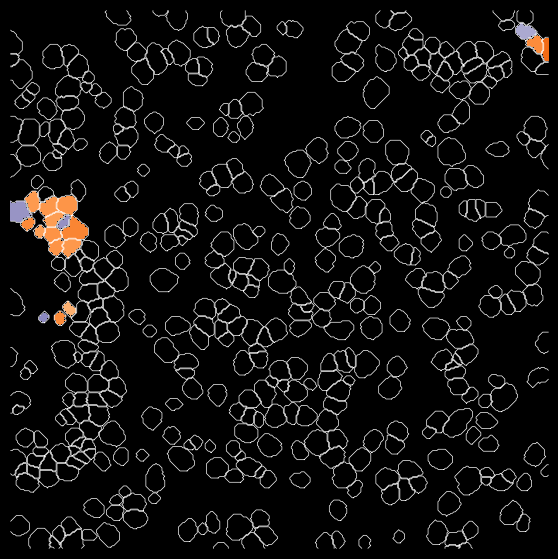

  0%|          | 0/132 [00:00<?, ?it/s]

  0%|          | 0/116 [00:00<?, ?it/s]

  0%|          | 0/738 [00:00<?, ?it/s]

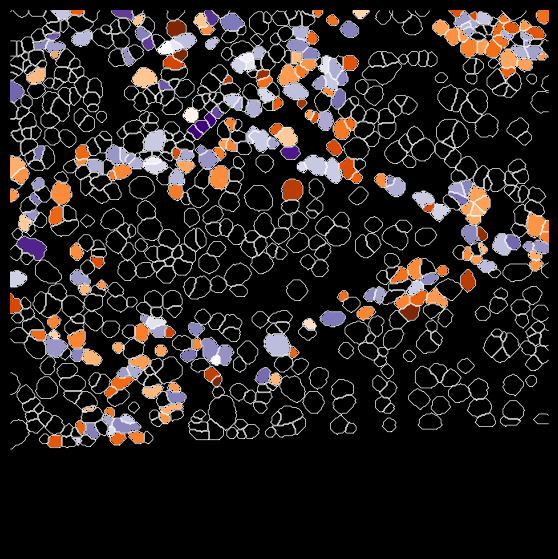

  0%|          | 0/194 [00:00<?, ?it/s]

  0%|          | 0/146 [00:00<?, ?it/s]

  0%|          | 0/931 [00:00<?, ?it/s]

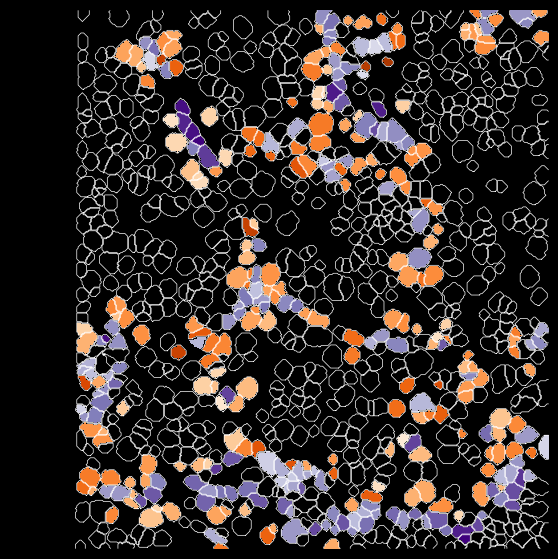

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/1293 [00:00<?, ?it/s]

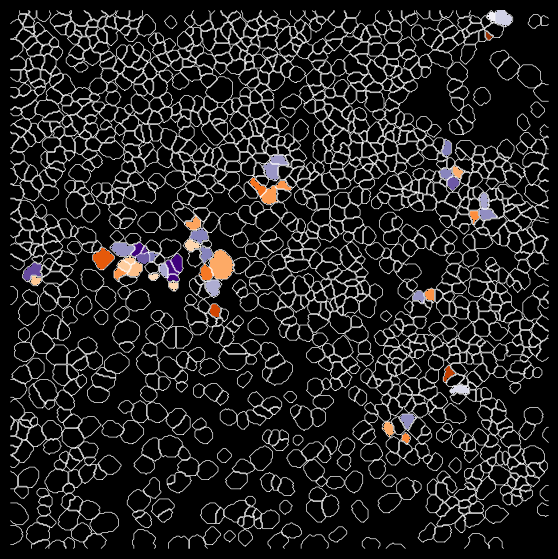

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/1209 [00:00<?, ?it/s]

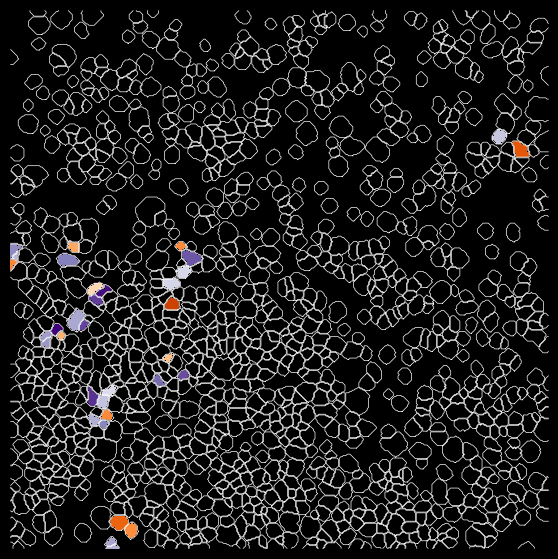

  0%|          | 0/47 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/533 [00:00<?, ?it/s]

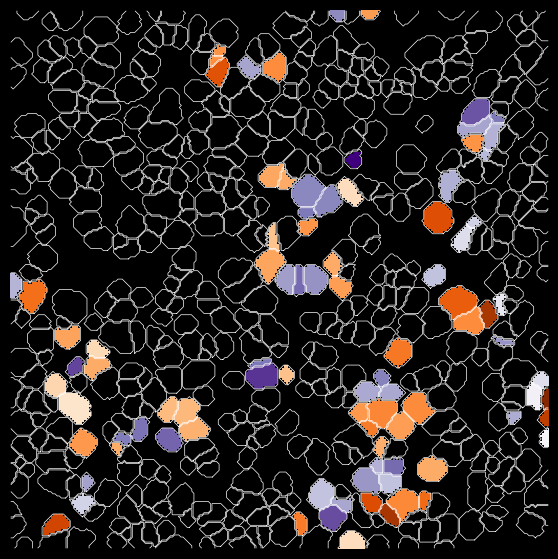

  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/415 [00:00<?, ?it/s]

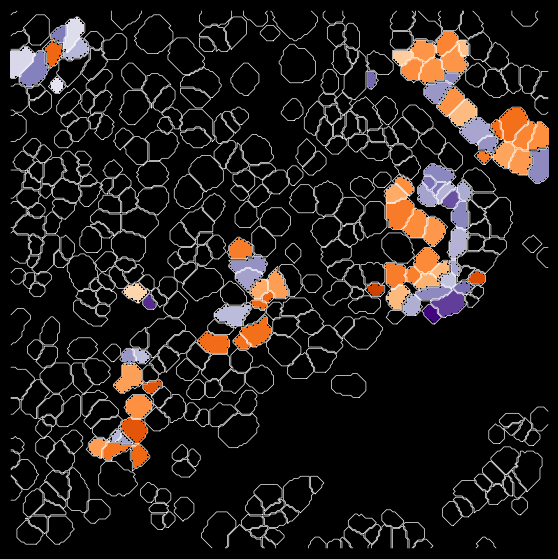

  0%|          | 0/99 [00:00<?, ?it/s]

  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/474 [00:00<?, ?it/s]

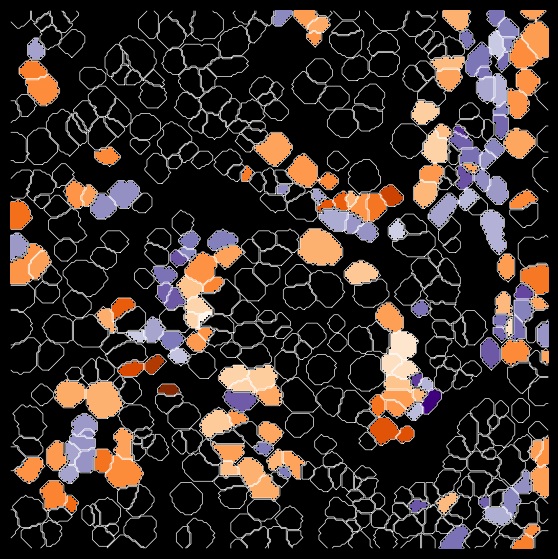

  0%|          | 0/210 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/1072 [00:00<?, ?it/s]

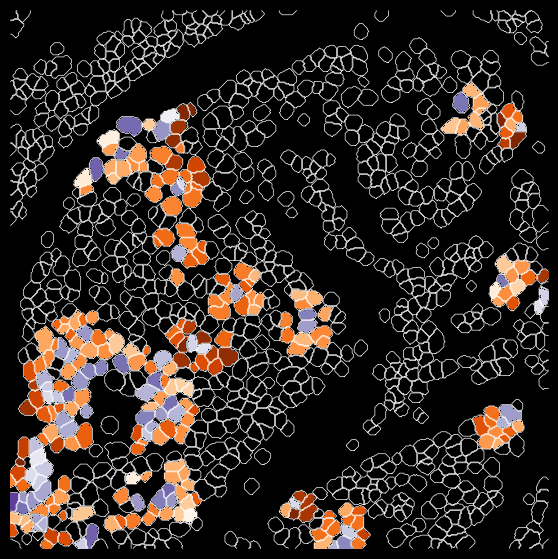

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/1180 [00:00<?, ?it/s]

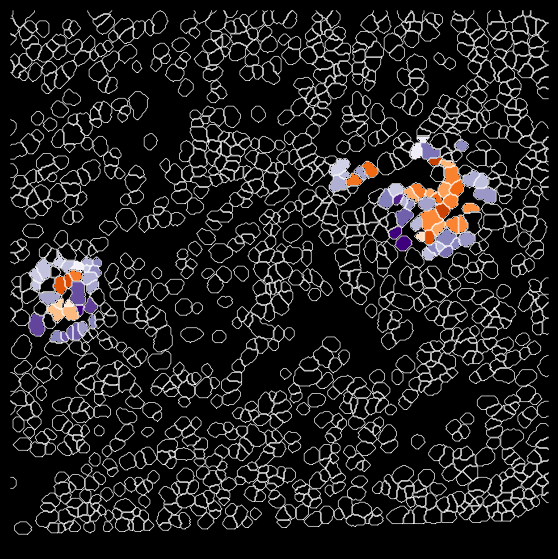

  0%|          | 0/181 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

  0%|          | 0/1133 [00:00<?, ?it/s]

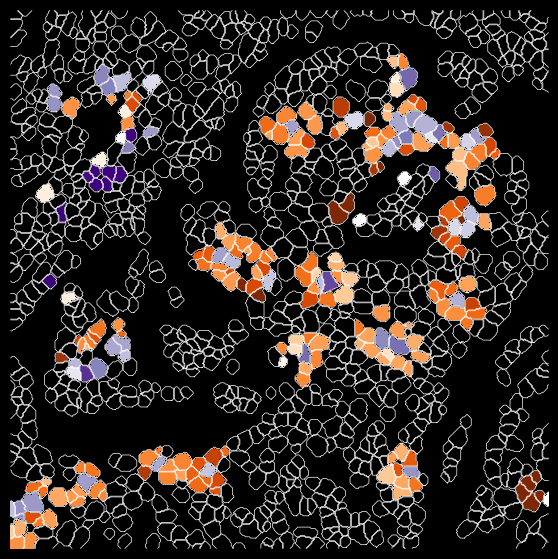

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/450 [00:00<?, ?it/s]

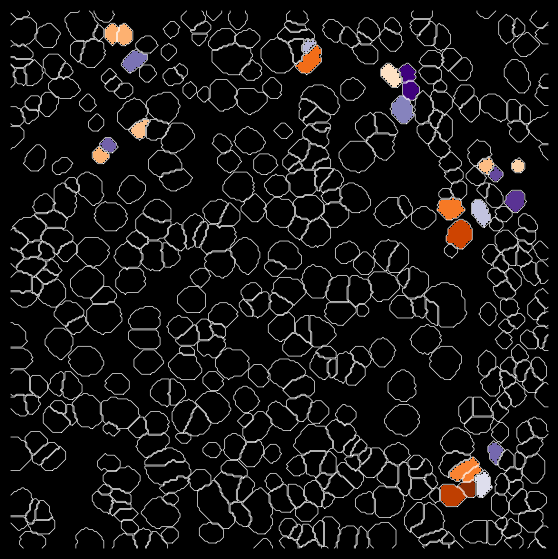

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/33 [00:00<?, ?it/s]

  0%|          | 0/645 [00:00<?, ?it/s]

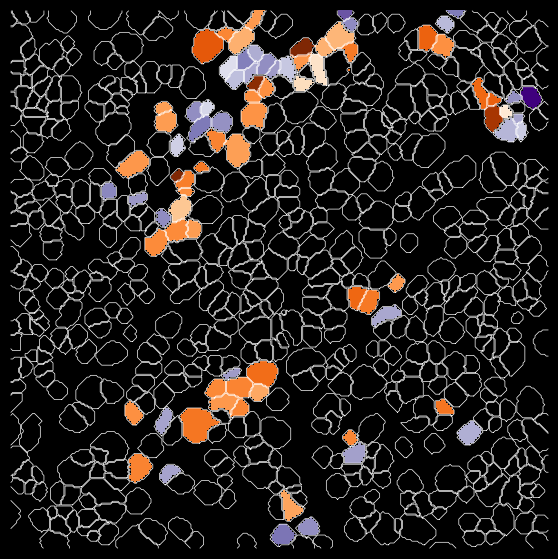

In [86]:
import warnings
warnings.filterwarnings('ignore')

attr = 'Type_new'
interaction=('Tumor', 'CD3+')
cmap1 = 'Oranges'
cmap2 = 'Purples'
cmap_dist = 'cividis_r'
mz = '42.0m/z Lipid'

ct1_ratios = []
ct2_ratios = []
distance_ct1 = []
distance_ct2 = []

for spl in datasets:
    # Get sims 
    adata_sims_subset = adata_raw[adata_raw.obs.Dataset == spl]
    df_sims = pd.DataFrame(adata_sims_subset.X, columns=adata_sims_subset.var_names, index=adata_sims_subset.obs.Cell)

    # Get Graph info
    G = spadata.G[spl]['radius']
    
    # Extract cell interactions
    data = spadata.obs[spl][attr]
    node_interactions = get_node_interactions(G, data)

    # Get specific interationcs
    interactions = get_interaction_type(node_interactions, interaction)
    
    if len(interactions) == 0:
        print(f"{spl} no interactions")
        continue 
        
    # Extract cell id
    cells  = np.unique(pd.concat([interactions.source, interactions.target]))
    
    # Get ratio per cell neighbors
    group = interactions.groupby(['source_label'])
    ratios = []

    for source, df_group in group:
        group_cell = df_group.groupby(['source'])
        for cell_id, df_cell in group_cell:
            # Get metabolites count on cell vs neighbor
            nei_list = df_cell.target.tolist()
            cell_sims = df_sims.loc[cell_id]
            nei_sims = df_sims.loc[nei_list]
            ratio = cell_sims.div(nei_sims.mean())
            ratios.append(pd.DataFrame(ratio, columns=[cell_id]).T)

    ratios = pd.concat(ratios)        
    assert ratios.index.duplicated().all() == False
    
    # Get mask and contour
    mask = masks["_".join([experiment, spl])]
    contours = get_contour(mask)
    
    # Get ratios
    cell_type1 = interactions[interactions['source_label'] == interaction[0]].source.tolist()
    ratios_ct1 = ratios.loc[cell_type1]
    cell2intensity = ratios_ct1[mz].to_dict()
    img1 = create_intensity_cell(mask, cell2intensity)

    cell_type2 = interactions[interactions['source_label'] == interaction[1]].source.tolist()
    ratios_ct2 = ratios.loc[cell_type2]
    cell2intensity = ratios_ct2[mz].to_dict()
    img2 = create_intensity_cell(mask, cell2intensity)
    
    # Get distance to CD31 positif cells for all cells
    try:
        distance_df = pd.read_csv(cd31_path / f'{spl}.csv')
        distance_df.columns = ['Cell', 'Proximity to CD31']
    except:
        continue
    label2cell = {}
    cell_ids = adata_sims_subset.obs.Cell.to_list()

    for i, cell in enumerate(cell_ids):
        label2cell[cell] = distance_df.loc[distance_df.Cell == cell, 'Proximity to CD31'].item()

    img = create_intensity_cell(mask, label2cell)

    # Plot
    fig, ax = plt.subplots(figsize=(7, 7), facecolor='k')
    # ax.imshow(img, cmap=cmap_dist, vmax=np.nanquantile(img, 0.95), alpha=0.5)
    ax.axis("off")
    ax.imshow(img1, cmap=cmap1, vmin=0.6, vmax=1.4)
    ax.imshow(img2, cmap=cmap2, vmin=0.6, vmax=1.4)
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    
    # fig.savefig(f'D31_{mz[:4]}_{interaction}_{spl}.png',bbox_inches='tight',transparent=True, pad_inches=0)
    plt.show()
    
    # Add info to ratios
    ct1_ratios.append(ratios_ct1)
    ct2_ratios.append(ratios_ct2)
    distance_ct1.append(np.array([label2cell[c] for c in cell_type1]).flatten())
    distance_ct2.append(np.array([label2cell[c] for c in cell_type2]).flatten())

In [87]:
# Summary plot
ct1_ratio = pd.concat(ct1_ratios)
ct2_ratio = pd.concat(ct2_ratios)
dist_ct1 = np.concatenate(distance_ct1)
dist_ct2 = np.concatenate(distance_ct2)

ct1_ratio['Distance CD31'] = dist_ct1
ct2_ratio['Distance CD31'] = dist_ct2

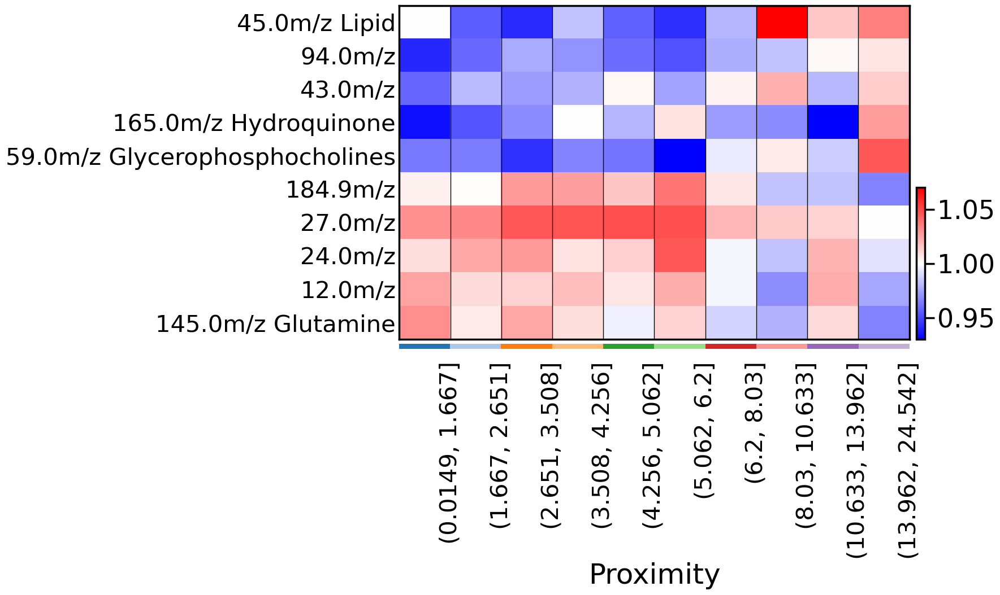

In [88]:
df = ct1_ratio
df_corr = df.corr()

n = 5
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,8), vmin=0.93, vmax=1.07)

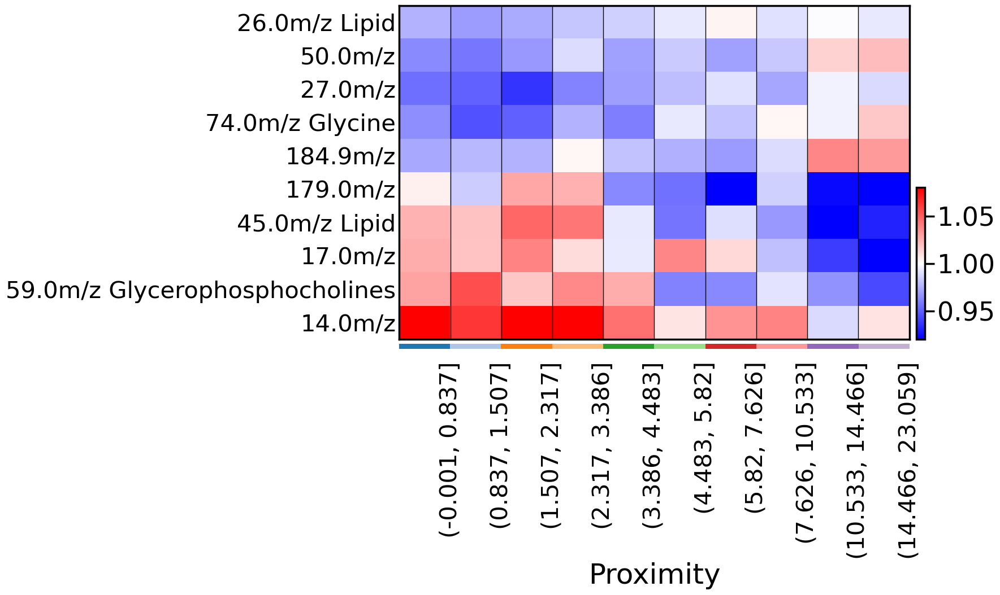

In [89]:
df = ct2_ratio
df_corr = df.corr()

n = 5
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,8), vmin=0.92, vmax=1.08)

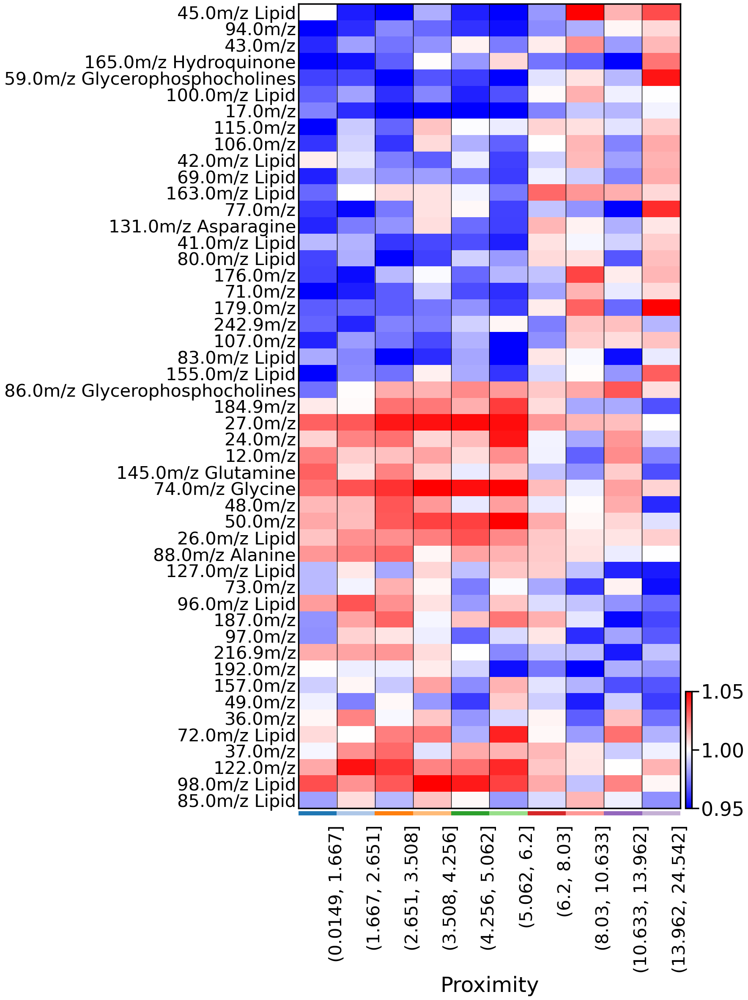

In [93]:
df = ct1_ratio
df_corr = df.corr()

n = 25
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,25), vmin=0.95, vmax=1.05)

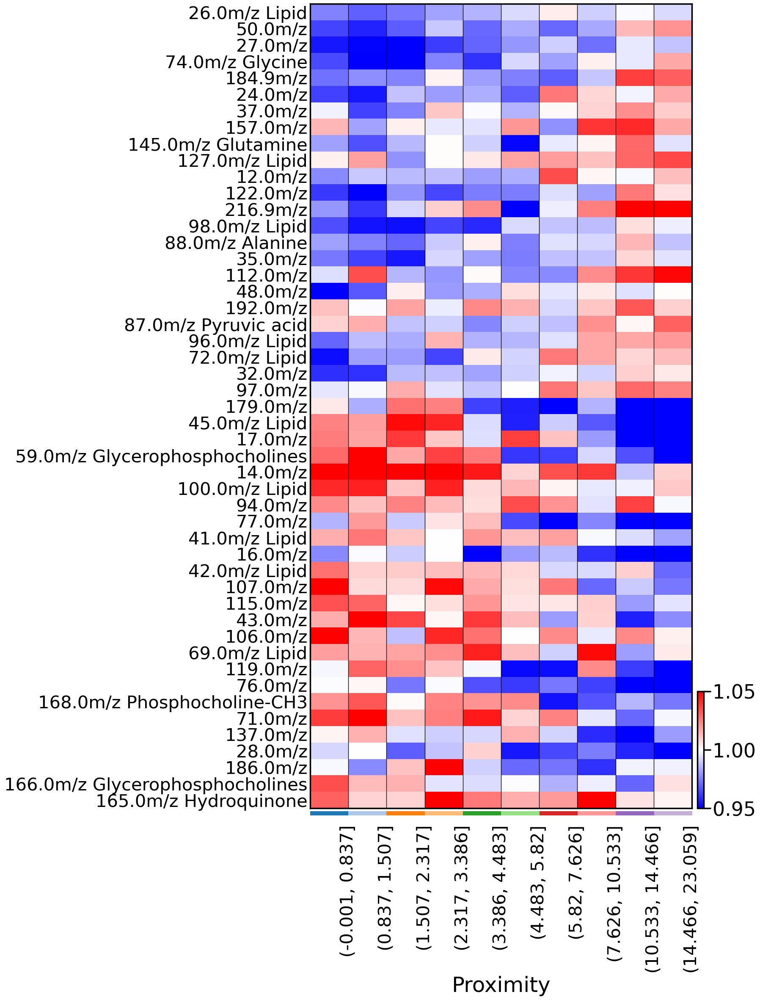

In [94]:
df = ct2_ratio
df_corr = df.corr()

n = 25
marker = 'Distance CD31'
n_cut = 10

# Get positive and negative correlation
corr_pos = df_corr.loc[marker].nlargest(25).index.tolist()
corr_neg = df_corr.loc[marker].nsmallest(25).index.tolist()

# Get only SIMS masses
corr_pos = [corr for corr in corr_pos if corr in SIMS_nm_subset][:n]
corr_neg = [corr for corr in corr_neg if corr in SIMS_nm_subset][:n]
corr_list = [marker] + corr_pos + corr_neg

# Get range 
df_intensity = df[corr_list]
df_intensity.sort_values(by=[marker], inplace=True)
df_intensity[f'{marker} cut'] = pd.qcut(df_intensity[marker], n_cut, duplicates='drop') 

# Sort by Distance
df_sort = df_intensity.groupby(f'{marker} cut').median()
df_sort = df_sort.drop([marker], axis=1)

# create adata
adata_cd31_corr = sc.AnnData(df_sort)
adata_cd31_corr.var_names = df_sort.columns.tolist()
adata_cd31_corr.obs['Proximity'] = df_sort.index.tolist()

with sns.plotting_context('poster', font_scale=1.5):
    sc.pl.heatmap(adata_cd31_corr, adata_cd31_corr.var_names, groupby='Proximity', swap_axes=True, cmap='bwr', figsize=(12,25), vmin=0.95, vmax=1.05)

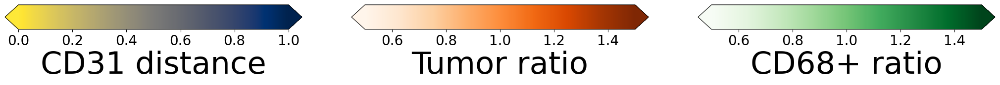

In [208]:
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(20, 5))
ax1 = fig.add_axes([0.0, 0.15, 0.3, 0.1])
ax2 = fig.add_axes([0.35, 0.15, 0.3, 0.1])
ax3 = fig.add_axes([0.7, 0.15, 0.3, 0.1])

norm = mpl.colors.Normalize(vmin=0.5, vmax=1.5)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax2, cmap=cmap1,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'{interaction[0]} ratio', fontsize=45)

# 2nd Cell type
cb2 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap2,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb2.set_label(f'CD68+ ratio', fontsize=45)

# Distance map
norm = mpl.colors.Normalize(vmin=0, vmax=1)

cb3 = mpl.colorbar.ColorbarBase(ax1, cmap=cmap_dist,
                                norm=norm,  extend='both',
                                orientation='horizontal')
cb3.set_label(f'CD31 distance', fontsize=45)

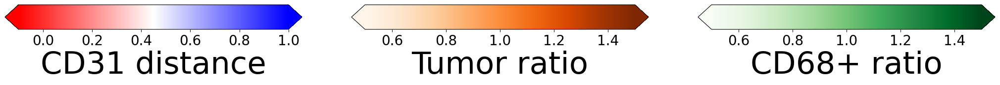

In [209]:
import matplotlib.pyplot as plt
import matplotlib as mpl
plt.rcParams.update({'font.size':20})

# Make a figure and axes with dimensions as desired.
fig = plt.figure(figsize=(20, 5))
ax1 = fig.add_axes([0.0, 0.15, 0.3, 0.1])
ax2 = fig.add_axes([0.35, 0.15, 0.3, 0.1])
ax3 = fig.add_axes([0.7, 0.15, 0.3, 0.1])

norm = mpl.colors.Normalize(vmin=0.5, vmax=1.5)

# Fist Cell type
cb1 = mpl.colorbar.ColorbarBase(ax2, cmap=cmap1,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb1.set_label(f'{interaction[0]} ratio', fontsize=45)

# 2nd Cell type
cb2 = mpl.colorbar.ColorbarBase(ax3, cmap=cmap2,
                                norm=norm, extend='both',
                                orientation='horizontal')
cb2.set_label(f'CD68+ ratio', fontsize=45)

# Distance map
norm = mpl.colors.Normalize(vmin=1, vmax=0)

cb3 = mpl.colorbar.ColorbarBase(ax1, cmap='bwr_r',
                                norm=norm,  extend='both',
                                orientation='horizontal')
cb3.set_label(f'CD31 distance', fontsize=45)

# Competition variation across tissue

In [111]:
type_new = adata_IMC.obs['Type'].to_numpy()
type_new[(adata_IMC[:,'CD68'].X > 0.1).flatten().tolist()] = 'CD68+'
adata_IMC.obs['Type_new'] = type_new
adata_IMC.obs['Type_new'] = adata_IMC.obs['Type_new'].astype('category')

In [112]:
# Create spatial omics data objects

spadata = SpatialOmics()
spl = pd.DataFrame({'Dataset': adata_IMC.obs.Dataset.unique()})
spadata.spl = spl

for d in adata_IMC.obs.Dataset.unique():
    adata_subset = adata_IMC[adata_IMC.obs.Dataset == d, :]
    
    obs = adata_subset.obs.copy()
    obs['x'] = adata_subset.obsm['spatial'][:,1].tolist()
    obs['y'] = adata_subset.obsm['spatial'][:,0].tolist()
    obs['cell_id'] = obs['Cell']
    obs = obs.set_index('cell_id')
    spadata.obs[d] = obs
    spadata.X[d] = pd.DataFrame(adata_subset.X, columns=adata_subset.var_names, index=adata_subset.obs.Cell.tolist())
    spadata.var[d] = adata_subset.var
    spadata.masks[d] = {'cellmasks': masks["_".join([experiment, d])]}

In [113]:
# Loop through all region and create different cell neighborhood graph
datasets = spadata.spl.Dataset

for spl in datasets:
    # kNN graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['knn']
    config['builder_params']['n_neighbors'] = 5 # set parameter k
    ath.graph.build_graph(spadata, spl, builder_type='knn', mask_key='cellmasks', config=config)

    # Radius graph
    config = GRAPH_BUILDER_DEFAULT_PARAMS['radius']
    config['builder_params']['radius'] = 20 # set radius
    ath.graph.build_graph(spadata, spl, builder_type='radius', mask_key='cellmasks', config=config)


In [115]:
import warnings
warnings.filterwarnings('ignore')

attr = 'Type_new'
interaction=('Tumor', 'CD68+')
cmap1 = 'Oranges'
cmap2 = 'Purples'
cmap_dist = 'cividis_r'
mz = '42.0m/z Lipid'

ct1_ratios = []
ct2_ratios = []
distance_ct1 = []
distance_ct2 = []

for spl in datasets:
    # Get sims 
    adata_sims_subset = adata_raw[adata_raw.obs.Dataset == spl]
    df_sims = pd.DataFrame(adata_sims_subset.X, columns=adata_sims_subset.var_names, index=adata_sims_subset.obs.Cell)

    # Get Graph info
    G = spadata.G[spl]['radius']
    
    # Extract cell interactions
    data = spadata.obs[spl][attr]
    node_interactions = get_node_interactions(G, data)

    # Get specific interationcs
    interactions = get_interaction_type(node_interactions, interaction)
    
    if len(interactions) == 0:
        print(f"{spl} no interactions")
        continue 
        
    # Extract cell id
    cells  = np.unique(pd.concat([interactions.source, interactions.target]))
    
    # Get ratio per cell neighbors
    group = interactions.groupby(['source_label'])
    ratios = []

    for source, df_group in group:
        group_cell = df_group.groupby(['source'])
        for cell_id, df_cell in group_cell:
            # Get metabolites count on cell vs neighbor
            nei_list = df_cell.target.tolist()
            cell_sims = df_sims.loc[cell_id]
            nei_sims = df_sims.loc[nei_list]
            ratio = cell_sims.div(nei_sims.mean())
            ratios.append(pd.DataFrame(ratio, columns=[cell_id]).T)

    ratios = pd.concat(ratios)        
    assert ratios.index.duplicated().all() == False
    
    # Get mask and contour
    mask = masks["_".join([experiment, spl])]
    contours = get_contour(mask)
    
    # Get ratios
    cell_type1 = interactions[interactions['source_label'] == interaction[0]].source.tolist()
    ratios_ct1 = ratios.loc[cell_type1]
    cell2intensity = ratios_ct1[mz].to_dict()
    img1 = create_intensity_cell(mask, cell2intensity)

    cell_type2 = interactions[interactions['source_label'] == interaction[1]].source.tolist()
    ratios_ct2 = ratios.loc[cell_type2]
    cell2intensity = ratios_ct2[mz].to_dict()
    img2 = create_intensity_cell(mask, cell2intensity)
    
    ratios_ct1['Tissue'] = spl
    ratios_ct2['Tissue'] = spl
    
    # Add info to ratios
    ct1_ratios.append(ratios_ct1)
    ct2_ratios.append(ratios_ct2)

    

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/158 [00:00<?, ?it/s]

  0%|          | 0/166 [00:00<?, ?it/s]

  0%|          | 0/123 [00:00<?, ?it/s]

  0%|          | 0/67 [00:00<?, ?it/s]

  0%|          | 0/173 [00:00<?, ?it/s]

  0%|          | 0/92 [00:00<?, ?it/s]

  0%|          | 0/171 [00:00<?, ?it/s]

  0%|          | 0/66 [00:00<?, ?it/s]

  0%|          | 0/165 [00:00<?, ?it/s]

  0%|          | 0/111 [00:00<?, ?it/s]

  0%|          | 0/104 [00:00<?, ?it/s]

  0%|          | 0/62 [00:00<?, ?it/s]

  0%|          | 0/53 [00:00<?, ?it/s]

  0%|          | 0/43 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/92 [00:00<?, ?it/s]

  0%|          | 0/74 [00:00<?, ?it/s]

  0%|          | 0/146 [00:00<?, ?it/s]

  0%|          | 0/78 [00:00<?, ?it/s]

  0%|          | 0/78 [00:00<?, ?it/s]

  0%|          | 0/164 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/55 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/26 [00:00<?, ?it/s]

  0%|          | 0/114 [00:00<?, ?it/s]

  0%|          | 0/47 [00:00<?, ?it/s]

  0%|          | 0/172 [00:00<?, ?it/s]

  0%|          | 0/48 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/193 [00:00<?, ?it/s]

  0%|          | 0/65 [00:00<?, ?it/s]

  0%|          | 0/68 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

  0%|          | 0/97 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

In [116]:
# Summary plot
ct1_ratio = pd.concat(ct1_ratios)
ct2_ratio = pd.concat(ct2_ratios)

In [117]:
# ct1_ratio['Cell Type'] = interaction[0]
# ct2_ratio['Cell Type'] = interaction[1]

In [118]:
df_median = ct2_ratio .iloc[:,:-1]

In [119]:
adata = ad.AnnData(df_median.values)
adata.var_names = df_median.columns
adata.obs['Tissue'] = ct2_ratio .iloc[:,-1].str.split('_').str[0].tolist()
adata.obs['Tissue'] = adata.obs['Tissue'].astype('category')

In [120]:
glucose_frag = ['71.0m/z', '87.0m/z Pyruvic acid', '99.0m/z Lipid', '119.0m/z', '141.0m/z Lipid', '74.0m/z Glycine',  '89.0m/z Lactic acid', '122.0m/z', ]
# glucose_frag = ['87.0m/z Pyruvic acid', '99.0m/z L-Frag', '74.0m/z Glycine',  '89.0m/z Lactic acid', '122.0m/z', ]

amino_acids = ['74.0m/z Glycine',  '88.0m/z Alanine', '104.0m/z Serine', '114.0m/z Proline', 
               '116.0m/z Valine', '118.0m/z Threonine', '120.0m/z Cysteine', 
               '130.0m/z Isoleucine/leucine', '131.0m/z Asparagine', '132.0m/z Aspartic acid', 
               '145.0m/z Glutamine', '146.0m/z Glutamic acid', '164.0m/z Phenylalanine']

cholesterol_frag = ['95.0m/z Cholesterol fragment', 
                    '109.0m/z Cholesterol fragment', 
                    '147.0m/z Cholesterol fragment',
                    '161.0m/z Cholesterol fragment']

lipids = [e for e in SIMS_nm_subset if 'Lipid' in e]

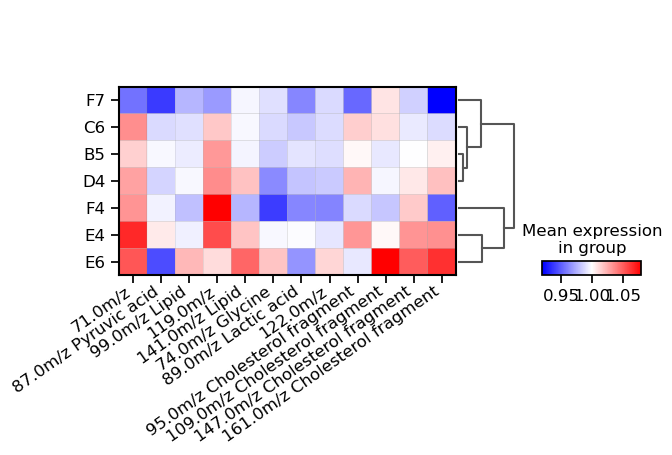

In [124]:
var = 'Tissue'
sc.tl.dendrogram(adata, groupby=var)
with sns.plotting_context('notebook', font_scale=1.2):
    ax = sc.pl.matrixplot(adata, var_names=glucose_frag+cholesterol_frag, 
                     groupby=var, cmap='bwr',
                     dendrogram=True, show=False, vmax=1.08, vmin=0.92)     
    xticklabels = ax['mainplot_ax'].get_xticklabels()
    ax['mainplot_ax'].set_xticklabels(xticklabels, rotation = 35, ha="right")
    ax['mainplot_ax'].tick_params(axis='x', pad=0)
    plt.show()